In [1]:
# update the git
! git add  .
! git commit -m "From Mac"
! git push

The file will have its original line endings in your working directory.
The file will have its original line endings in your working directory.
The file will have its original line endings in your working directory.
The file will have its original line endings in your working directory.


[master 53e34bae] From Mac
 4 files changed, 7660 insertions(+), 16 deletions(-)
 create mode 100644 NeuralNetwork/AAE/.ipynb_checkpoints/9a swiss roll-checkpoint.ipynb
 create mode 100644 NeuralNetwork/AAE/9a swiss roll.ipynb


To https://github.com/JaeDukSeo/Daily-Neural-Network-Practice-2
   1bbb2d0d..53e34bae  master -> master


In [1]:
# import library
import matplotlib 
matplotlib.use('Agg')
%matplotlib inline
import numpy as np
import sys, os,cv2
from sklearn.utils import shuffle
import matplotlib.pyplot as plt
from sklearn.preprocessing import OneHotEncoder
from skimage.transform import resize
from scipy.misc import imread
from imgaug import augmenters as iaa
import nibabel as nib
import imgaug as ia
from scipy.ndimage import zoom
from sklearn.utils import shuffle
import matplotlib.animation as animation

# Generate training data
import tensorflow as tf
old_v = tf.logging.get_verbosity()
tf.logging.set_verbosity(tf.logging.ERROR)
from tensorflow.examples.tutorials.mnist import input_data

plt.style.use('seaborn-white')
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
np.random.seed(6278)
tf.set_random_seed(6728)
ia.seed(6278)

In [2]:
# get the mnist data set
mnist = input_data.read_data_sets('../../Dataset/MNIST/', one_hot=True)
x_data, train_label, y_data, test_label = mnist.train.images, mnist.train.labels, mnist.test.images, mnist.test.labels
x_data_added,x_data_added_label = mnist.validation.images,mnist.validation.labels
x_data = x_data.reshape(-1, 28, 28, 1)  # 28x28x1 input img
y_data = y_data.reshape(-1, 28, 28, 1)  # 28x28x1 input img
x_data_added = x_data_added.reshape(-1, 28, 28, 1)
x_data = np.vstack((x_data,x_data_added))
train_label = np.vstack((train_label,x_data_added_label))

train_batch = np.zeros((20000,28,28,1))
test_batch = np.zeros((10000,28,28,1))
for iter in range(20000):
    train_batch[iter,:,:,:] = np.expand_dims(resize(x_data[iter,:,:,0],(28,28)),axis=3)

# print out the data shape and the max and min value
print(train_batch.shape)
print(train_batch.max())
print(train_batch.min())
print(train_label.shape)
print(train_label.max())
print(train_label.min())
print(test_batch.shape)
print(test_batch.max())
print(test_batch.min())
print(test_label.shape)
print(test_label.max())
print(test_label.min())

Extracting ../../Dataset/MNIST/train-images-idx3-ubyte.gz
Extracting ../../Dataset/MNIST/train-labels-idx1-ubyte.gz
Extracting ../../Dataset/MNIST/t10k-images-idx3-ubyte.gz
Extracting ../../Dataset/MNIST/t10k-labels-idx1-ubyte.gz


C:\ProgramData\Anaconda3\lib\site-packages\skimage\transform\_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
C:\ProgramData\Anaconda3\lib\site-packages\skimage\transform\_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:14: DeprecationWarning: Both axis > a.ndim and axis < -a.ndim - 1 are deprecated and will raise an AxisError in the future.
  


(20000, 28, 28, 1)
1.0
0.0
(60000, 10)
1.0
0.0
(10000, 28, 28, 1)
0.0
0.0
(10000, 10)
1.0
0.0


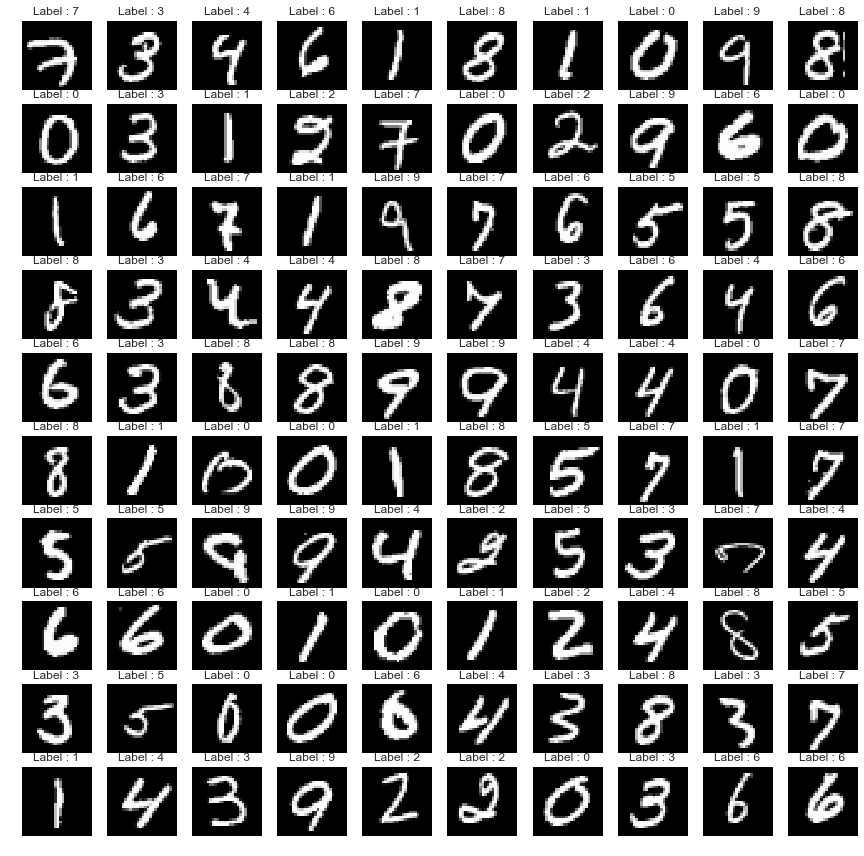

In [3]:
# show small amount of data
fig=plt.figure(figsize=(15, 15))
columns = 10 ; rows = 10
for i in range(1, columns*rows +1):
    fig.add_subplot(rows, columns, i)
    plt.imshow(np.squeeze(train_batch[i-1]),cmap='gray')
    plt.axis('off')
    plt.title("Label : "+str(np.argmax(train_label[i-1])))
plt.show()

In [26]:
# import all of the layers
def tf_elu(x):
    """ Exponential Linear Unit based on the ICCV 2015 paper
    https://arxiv.org/pdf/1511.07289.pdf

    Parameters
    ----------
    x : float
        The floating point number that is going to be applied to the ELU activation.

    Returns
    -------
    float
        Data with the same dimensions as the input after ELU

    """
    return tf.nn.elu(x)
def d_tf_elu(x):
    """Derivative of the Exponential Linear Unit base on the ICCV 2015 paper
    https://arxiv.org/pdf/1511.07289.pdf

    Parameters
    ----------
    x : type
        Description of parameter `x`.

    Returns
    -------
    type
        Description of returned object.

    """

    return tf.cast(tf.greater(x,0),tf.float32)  + (tf_elu(tf.cast(tf.less_equal(x,0),tf.float32) * x) + 1.0)

def tf_identiy(x)  : return x
def d_tf_identiy(x): return tf.ones_like(x,dtype=tf.float32)

def tf_relu(x):   return tf.nn.relu(x)
def d_tf_relu(x): return tf.cast(tf.greater(x,0.0),tf.float32)

def tf_lrelu(x): return tf.nn.leaky_relu(x,alpha=0.2)
def d_tf_lrelu(x): return tf.cast(tf.greater(x,0),tf.float32) + tf.cast(tf.less_equal(x,0),tf.float32) * 0.2

def tf_tanh(x): return tf.nn.tanh(x)
def d_tf_tanh(x): return 1 - tf_tanh(x) ** 2

def tf_sigmoid(x):   return tf.nn.sigmoid(x)
def d_tf_sigmoid(x): return tf_sigmoid(x) * (1.0-tf_sigmoid(x))

def tf_atan(x): return tf.atan(x)
def d_tf_atan(x): return 1.0/(1.0 + x**2)

def tf_softmax(x): return tf.nn.softmax(x)
def softabs(x): return tf.sqrt(x ** 2 + 1e-20)

def tf_logcosh(x): return tf.log(tf.cosh(x))
def d_tf_logcosh(x): return tf.tanh(x)

class FNN():

    def __init__(self,inc,outc,stddev=None,act=tf_elu,d_act=d_tf_elu,which_reg=0,init_x=False):
        if init_x:
            interval = np.sqrt(6.0 / (inc + outc + 1.0))
            self.w = tf.Variable(tf.random_uniform(shape=(inc, outc),minval=-interval,maxval=interval,dtype=tf.float32,seed=2))
            self.b = tf.Variable(tf.zeros(shape=[outc],dtype=tf.float32))
        else:
            self.w = tf.Variable(tf.random_normal([inc,outc],stddev=stddev,seed=2,dtype=tf.float32))
            self.b = tf.Variable(tf.zeros([outc],dtype=tf.float32))

        self.m,  self.v   = tf.Variable(tf.zeros_like(self.w)),tf.Variable(tf.zeros_like(self.w))
        self.m_b,self.v_b = tf.Variable(tf.zeros_like(self.b)),tf.Variable(tf.zeros_like(self.b))
        self.act,self.d_act = act,d_act
        self.which_reg = which_reg

    def getw(self): return self.w

    def feedforward(self,input=None):
        self.input  = input
        self.layer  = tf.matmul(input,self.w) + self.b
        self.layerA = self.act(self.layer)
        return self.layerA

    def backprop(self,gradient=None,learning_rate=None):
        grad_part_1 = gradient
        grad_part_2 = self.d_act(self.layer)
        grad_part_3 = self.input

        grad_middle = grad_part_1 * grad_part_2
        grad  = tf.matmul(tf.transpose(grad_part_3),grad_middle)/batch_size
        grad_b= tf.reduce_mean(grad_middle,0)/batch_size
        grad_pass = tf.matmul(grad_middle,tf.transpose(self.w))

        update_w = []
        update_w.append(tf.assign( self.m,self.m*beta1 + (1-beta1) * (grad)   ))
        update_w.append(tf.assign( self.v,self.v*beta2 + (1-beta2) * (grad ** 2)   ))
        m_hat = self.m / (1.-beta1)
        v_hat = self.v / (1.-beta2)
        adam_middle  = m_hat     *  learning_rate/(tf.sqrt(v_hat) + adam_e)
        update_w.append(tf.assign(self.w,tf.subtract(self.w,adam_middle )))

        update_w.append(tf.assign(self.m_b,self.m_b*beta1 + (1-beta1) * (grad_b)   ))
        update_w.append(tf.assign(self.v_b,self.v_b*beta2 + (1-beta2) * (grad_b ** 2)   ))
        m_hat_b = self.m_b / (1-beta1)
        v_hat_b = self.v_b / (1-beta2)
        adam_middle_b = m_hat_b *  learning_rate/(tf.sqrt(v_hat_b) + adam_e)
        update_w.append(tf.assign(self.b,tf.subtract(self.b,adam_middle_b ))) 
        
        return grad_pass,update_w

class CNN():

    def __init__(self,k,inc,out,stddev=0.005,which_reg=0,act=tf_elu,d_act=d_tf_elu,residual=False):
        self.w = tf.Variable(tf.random_normal([k,k,inc,out],stddev=stddev,seed=2,dtype=tf.float32))
        self.m,self.v = tf.Variable(tf.zeros_like(self.w)),tf.Variable(tf.zeros_like(self.w))
        self.act,self.d_act = act,d_act
        self.which_reg = which_reg
        self.residual = residual

    def getw(self): return self.w

    def feedforward(self,input,stride=1,padding='VALID'):
        self.input  = input
        if self.residual: 
            self.layer  = tf.nn.conv2d(input,self.w,strides=[1,stride,stride,1],padding='SAME')
            self.layerA = self.act(self.layer) + input
        else:
            self.layer  = tf.nn.conv2d(input,self.w,strides=[1,stride,stride,1],padding=padding)
            self.layerA = self.act(self.layer)
        return self.layerA

    def backprop(self,gradient,stride=1,padding='VALID'):
        grad_part_1 = gradient
        grad_part_2 = self.d_act(self.layer)
        grad_part_3 = self.input

        grad_middle = grad_part_1 * grad_part_2

        if self.residual: 
            grad = tf.nn.conv2d_backprop_filter(input = grad_part_3,filter_sizes = self.w.shape,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding='SAME'
            ) / batch_size
            
            grad_pass = tf.nn.conv2d_backprop_input(input_sizes = [batch_size] + list(grad_part_3.shape[1:]),filter= self.w,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding='SAME'
            ) + gradient
        else: 
            grad = tf.nn.conv2d_backprop_filter(input = grad_part_3,filter_sizes = self.w.shape,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding=padding
            ) / batch_size
        
            grad_pass = tf.nn.conv2d_backprop_input(input_sizes = [batch_size] + list(grad_part_3.shape[1:]),filter= self.w,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding=padding
            )

        # === Reg ===        
        if self.which_reg == 0:
            grad = grad

        if self.which_reg == 0.5:
            grad = grad + lamda * (tf.sqrt(tf.abs(self.w))) * (1.0/tf.sqrt(tf.abs(self.w)+ 10e-5)) * tf.sign(self.w)

        if self.which_reg == 1:
            grad = grad + lamda * tf.sign(self.w)

        if self.which_reg == 1.5:
            grad = grad + lamda * 1.0/(tf.sqrt(tf.square(self.w) + 10e-5)) * self.w

        if self.which_reg == 2:
            grad = grad + lamda * (1.0/tf.sqrt(tf.square(tf.abs(self.w))+ 10e-5)) * tf.abs(self.w) * tf.sign(self.w)

        if self.which_reg == 2.5:
            grad = grad + lamda * 2.0 * self.w

        if self.which_reg == 3:
            grad = grad + lamda * tf.pow(tf.pow(tf.abs(self.w),3)+ 10e-5,-0.66) * tf.pow(tf.abs(self.w),2) * tf.sign(self.w)

        if self.which_reg == 4:
            grad = grad + lamda * tf.pow(tf.pow(tf.abs(self.w),4)+ 10e-5,-0.75) * tf.pow(tf.abs(self.w),3) * tf.sign(self.w)

        update_w = []
        update_w.append(tf.assign( self.m,self.m*beta1 + (1-beta1) * (grad)   ))
        update_w.append(tf.assign( self.v,self.v*beta2 + (1-beta2) * (grad ** 2)   ))
        m_hat = self.m / (1-beta1)
        v_hat = self.v / (1-beta2)
        adam_middel = learning_rate/(tf.sqrt(v_hat) + adam_e)
        update_w.append(tf.assign(self.w,tf.subtract(self.w,tf.multiply(adam_middel,m_hat)  )))
        return grad_pass,update_w

In [41]:
# hyper class
num_epoch = 10001; batch_size = 100; print_size = 25; lamda = 0.0
beta1,beta2,adam_e = 0.9,0.999,1e-8; eps = 1e-10

aimed_range = tf.placeholder(shape=[],dtype=tf.float32)

e1 = FNN(784,1000,       stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
e2 = FNN(1000,1000,      stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
e3 = FNN(1000,2,         stddev=0.005,which_reg=0,act=tf_identiy,d_act=d_tf_identiy)

d1 = FNN(2,1000,         stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
d2 = FNN(1000,1000,      stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
d3 = FNN(1000,784,       stddev=0.005,which_reg=0,act=tf_sigmoid,d_act=d_tf_sigmoid)

discrim1 = FNN(2,1000   ,stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
discrim2 = FNN(1000,1000,stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
discrim3 = FNN(1000,1   ,stddev=0.005,which_reg=0,act=tf_sigmoid,d_act=d_tf_sigmoid)

# 0.00005
def norm_vec(x,aimed_range):
    return ((x-tf.reduce_min(x,1)[:,None]) /(tf.reduce_max(x,1)-tf.reduce_min(x,1))[:,None]) *\
           (aimed_range + aimed_range) - aimed_range

In [42]:
# 0. Update the encoding and decoding
x0  = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr0 = tf.placeholder(shape=[],dtype=tf.float32)

elayer1 = e1.feedforward(x0)
elayer2 = e2.feedforward(elayer1)
elayer3 = e3.feedforward(elayer2)

dlayer1 = d1.feedforward(elayer3)
dlayer2 = d2.feedforward(dlayer1)
dlayer3 = d3.feedforward(dlayer2)

recon_cost = -tf.reduce_mean(x0*tf.log(dlayer3+10e-10)+ (1.0-x0)*tf.log(1.0-dlayer3+10e-10))
# auto_train = tf.train.AdamOptimizer(learning_rate=lr0).minimize(recon_cost)
recon_ = (-(x0/(dlayer3+10e-10)) + (1.0-x0)/(1.0-dlayer3+10e-10))/(batch_size)


dgrad3,dgrad3_up = d3.backprop(norm_vec(recon_,aimed_range)+recon_,learning_rate=lr0)
dgrad2,dgrad2_up = d2.backprop(norm_vec(dgrad3,aimed_range)+dgrad3,learning_rate=lr0)
dgrad1,dgrad1_up = d1.backprop(norm_vec(dgrad2,aimed_range)+dgrad2,learning_rate=lr0)

egrad3,egrad3_up = e3.backprop(norm_vec(dgrad1,aimed_range)+dgrad1,learning_rate=lr0)
egrad2,egrad2_up = e2.backprop(norm_vec(egrad3,aimed_range)+egrad3,learning_rate=lr0)
egrad1,egrad1_up = e1.backprop(norm_vec(egrad2,aimed_range)+egrad2,learning_rate=lr0)

grad0_update = dgrad3_up + dgrad2_up + dgrad1_up + egrad3_up + egrad2_up + egrad1_up

In [43]:
# 1. Update the discrimator (with encode)
x1       = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr1      = tf.placeholder(shape=[],dtype=tf.float32)
x1_label = tf.zeros((batch_size,1),dtype=tf.float32)

elayer1_dis = e1.feedforward(x1)
elayer2_dis = e2.feedforward(elayer1_dis)
elayer3_dis = e3.feedforward(elayer2_dis)

dislayer1_dis1= discrim1.feedforward(elayer3_dis)
dislayer2_dis1= discrim2.feedforward(dislayer1_dis1)
dislayer3_dis1= discrim3.feedforward(dislayer2_dis1)

dis_cost1 = - tf.reduce_mean(x1_label * tf.log(dislayer3_dis1 + 10e-10) + (1.-x1_label) * tf.log(1.-dislayer3_dis1+10e-10))
dis_grad1 = (-(x1_label/(dislayer3_dis1+10e-10)) + (1.0-x1_label)/(1.0-dislayer3_dis1+10e-10))/(batch_size)

disgrad31,disgrad31_up = discrim3.backprop(dis_grad1,learning_rate=lr1)
disgrad21,disgrad21_up = discrim2.backprop(disgrad31,learning_rate=lr1)
disgrad11,disgrad11_up = discrim1.backprop(disgrad21,learning_rate=lr1)

grad1_update = disgrad31_up + disgrad21_up + disgrad11_up

In [44]:
# 2. Update the discrimator (with prior)
x2       = tf.placeholder(shape=[batch_size,2],dtype=tf.float32)
lr2      = tf.placeholder(shape=[],dtype=tf.float32)
x2_label = tf.ones((batch_size,1),dtype=tf.float32)

dislayer1_dis2= discrim1.feedforward(x2)
dislayer2_dis2= discrim2.feedforward(dislayer1_dis2)
dislayer3_dis2= discrim3.feedforward(dislayer2_dis2)

dis_cost2 = - tf.reduce_mean(x2_label * tf.log(dislayer3_dis2 + 10e-10) + (1.-x2_label) * tf.log(1.-dislayer3_dis2+10e-10))
dis_grad2 = (-(x2_label/(dislayer3_dis2+10e-10)) + (1.0-x2_label)/(1.0-dislayer3_dis2+10e-10))/(batch_size)

disgrad32,disgrad32_up = discrim3.backprop(dis_grad2,learning_rate=lr2)
disgrad22,disgrad22_up = discrim2.backprop(disgrad32,learning_rate=lr2)
disgrad12,disgrad12_up = discrim1.backprop(disgrad22,learning_rate=lr2)

grad2_update = disgrad32_up + disgrad22_up + disgrad12_up

In [45]:
# 3. update the generator here 
x3       = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr3      = tf.placeholder(shape=[],dtype=tf.float32)
x3_label = tf.ones((batch_size,1),dtype=tf.float32)

elayer13 = e1.feedforward(x3)
elayer23 = e2.feedforward(elayer13)
elayer33 = e3.feedforward(elayer23)

dlayer13 = discrim1.feedforward(elayer33)
dlayer23 = discrim2.feedforward(dlayer13)
dlayer33 = discrim3.feedforward(dlayer23)

fake_cost = - tf.reduce_mean(x3_label * tf.log(dlayer33 + 10e-10) + (1.-x3_label) * tf.log(1.-dlayer33+10e-10))
fake_grad = (-(x3_label/(dlayer33+10e-10)) + (1.0-x3_label)/(1.0-dlayer33+10e-10))/(batch_size)

fake_disgrad3,_ = discrim3.backprop(fake_grad,learning_rate=lr3)
fake_disgrad2,_ = discrim2.backprop(fake_disgrad3,learning_rate=lr3)
fake_disgrad1,_ = discrim1.backprop(fake_disgrad2,learning_rate=lr3)

fake_egrad3,fake_egrad3_up = e3.backprop(norm_vec(fake_disgrad1,aimed_range)+fake_disgrad1,learning_rate=lr3)
fake_egrad2,fake_egrad2_up = e2.backprop(norm_vec(fake_egrad3  ,aimed_range)+fake_egrad3  ,learning_rate=lr3)
fake_egrad1,fake_egrad1_up = e1.backprop(norm_vec(fake_egrad2  ,aimed_range)+fake_egrad2  ,learning_rate=lr3)

fake_grad_update = fake_egrad3_up + fake_egrad2_up + fake_egrad1_up

 iter: 0 batch: 19900 range: 5e-05 recon cost: 0.2510671 zero cost: 0.022544432								 one  cost: 0.046259247 fake cost: 4.949854374

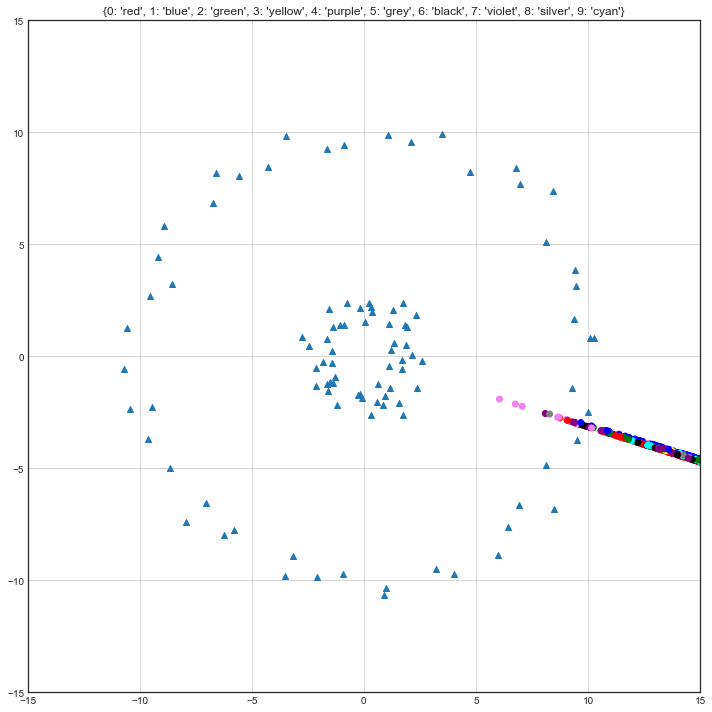

 iter: 25 batch: 19900 range: 8.598904926103946e-07 recon cost: 0.19489235 zero cost: 0.43603826								 one  cost: 0.5661984 fake cost: 1.11394512445

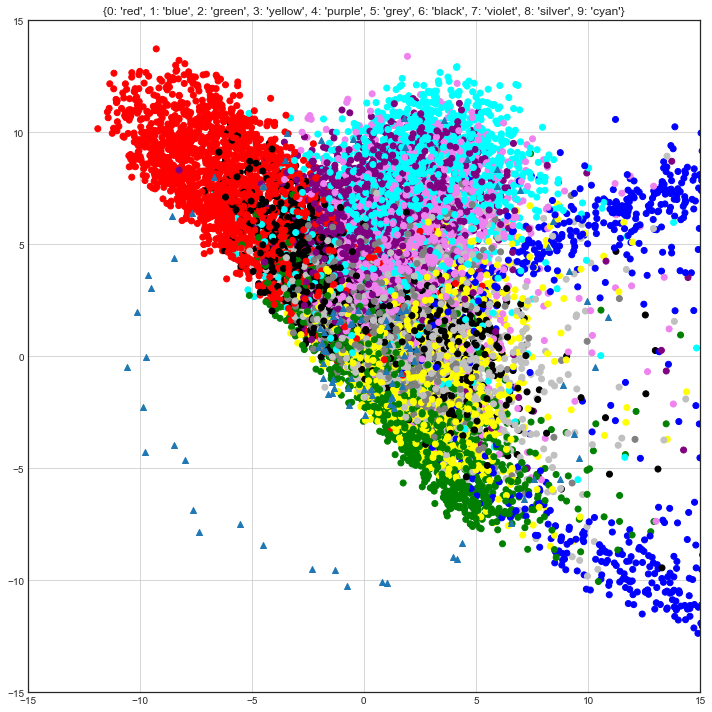

 iter: 50 batch: 19900 range: 1.4788233185634945e-08 recon cost: 0.17899004 zero cost: 0.5385747								 one  cost: 0.6295038 fake cost: 1.2165779276

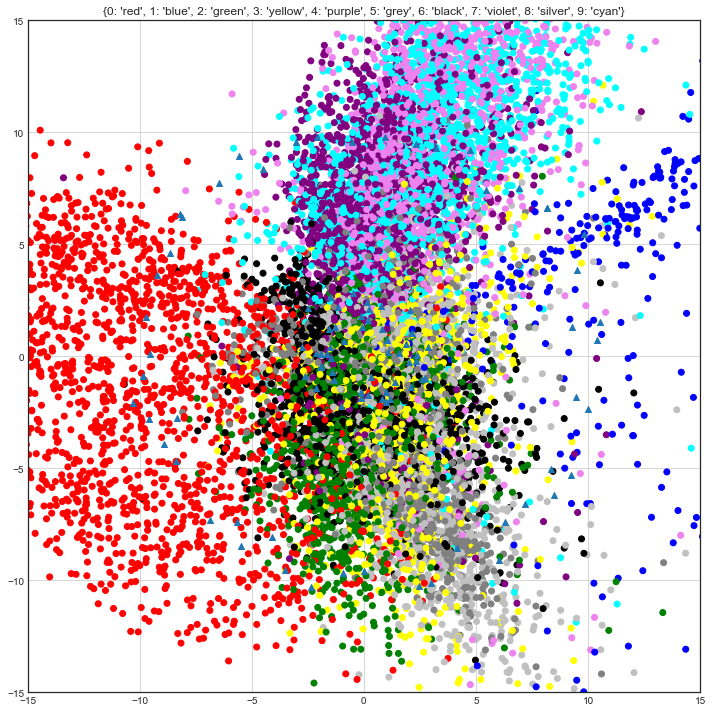

 iter: 75 batch: 19900 range: 2.543252223766605e-10 recon cost: 0.17340684 zero cost: 0.55678284								 one  cost: 0.5236372 fake cost: 1.2284386965

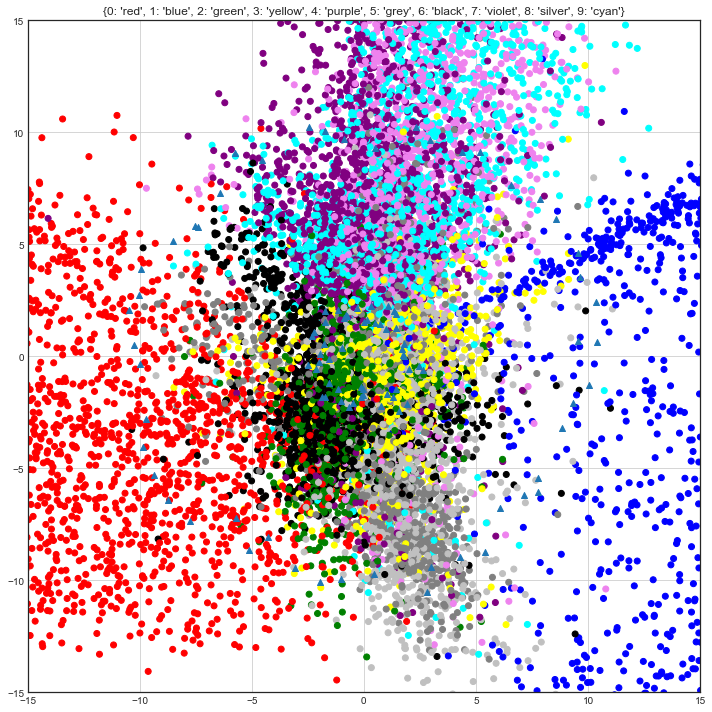

 iter: 100 batch: 19900 range: 4.373836815054297e-12 recon cost: 0.16966999 zero cost: 0.5643753								 one  cost: 0.5644213 fake cost: 1.0765272573

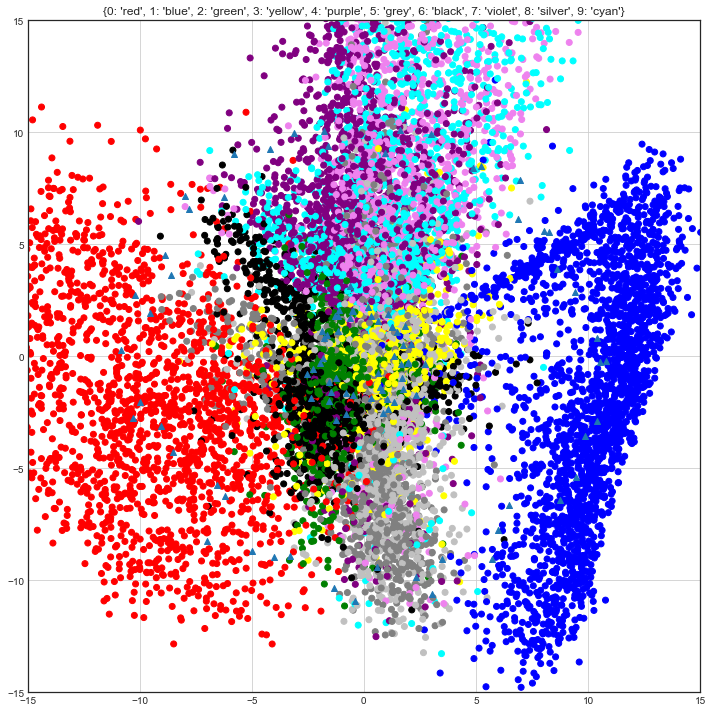

 iter: 125 batch: 19900 range: 7.522041386989034e-14 recon cost: 0.16656427 zero cost: 0.5868119								 one  cost: 0.5581325 fake cost: 0.98491611644

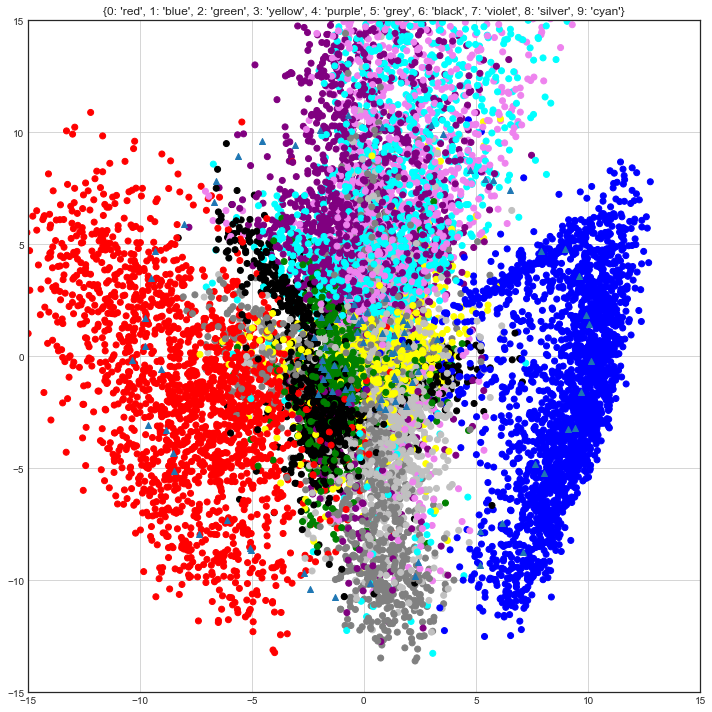

 iter: 150 batch: 19900 range: 1.2936263747387554e-15 recon cost: 0.1639695 zero cost: 0.5902887								 one  cost: 0.5677445 fake cost: 0.98188829583

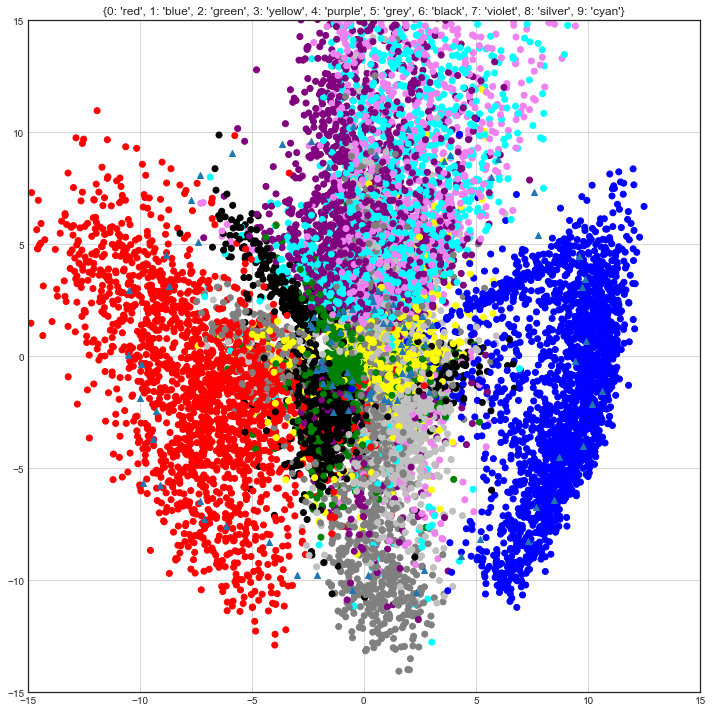

 iter: 175 batch: 19900 range: 2.2247540412558147e-17 recon cost: 0.16190845 zero cost: 0.57061696								 one  cost: 0.59215224 fake cost: 1.02097186

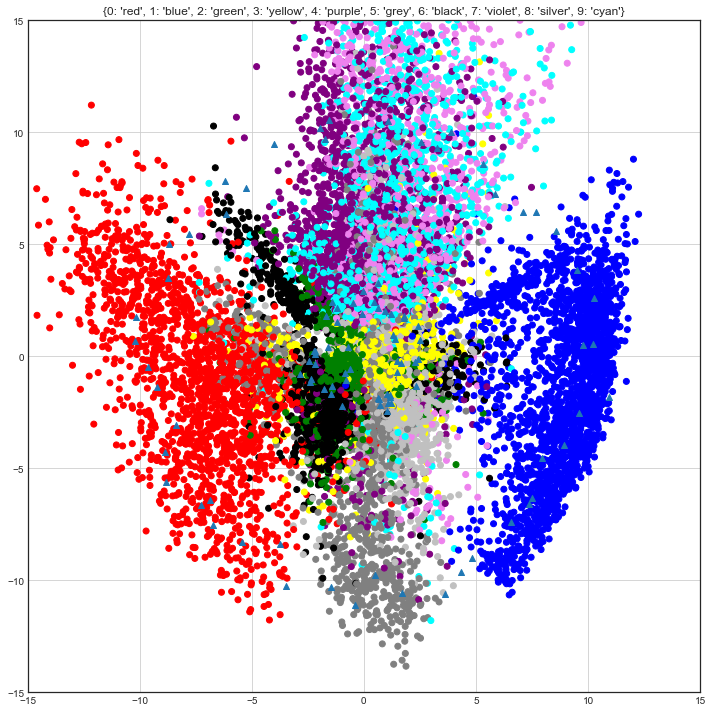

 iter: 200 batch: 19900 range: 3.826089696944859e-19 recon cost: 0.16024737 zero cost: 0.5488868								 one  cost: 0.5235822 fake cost: 1.07617072844

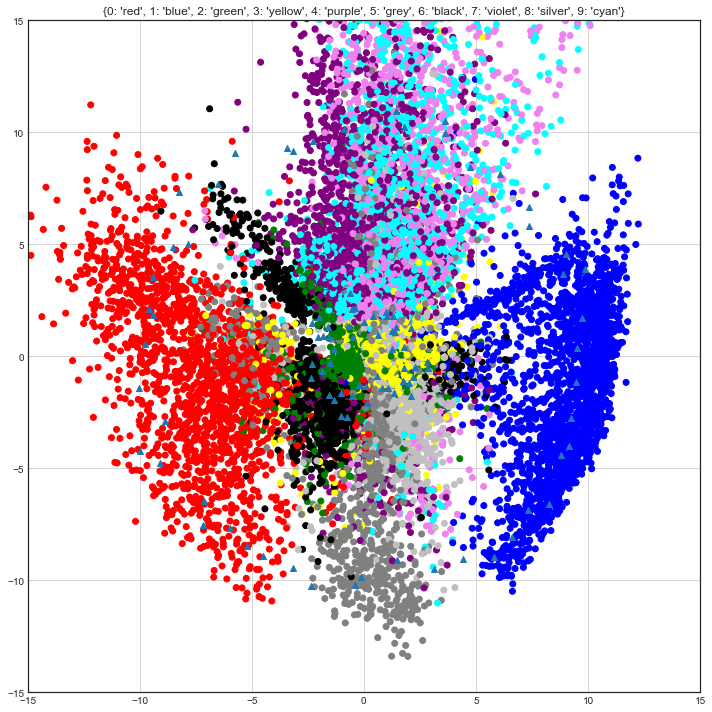

 iter: 225 batch: 19900 range: 6.58003630855494e-21 recon cost: 0.15906227 zero cost: 0.5398223								 one  cost: 0.4999913 fake cost: 1.13771995244

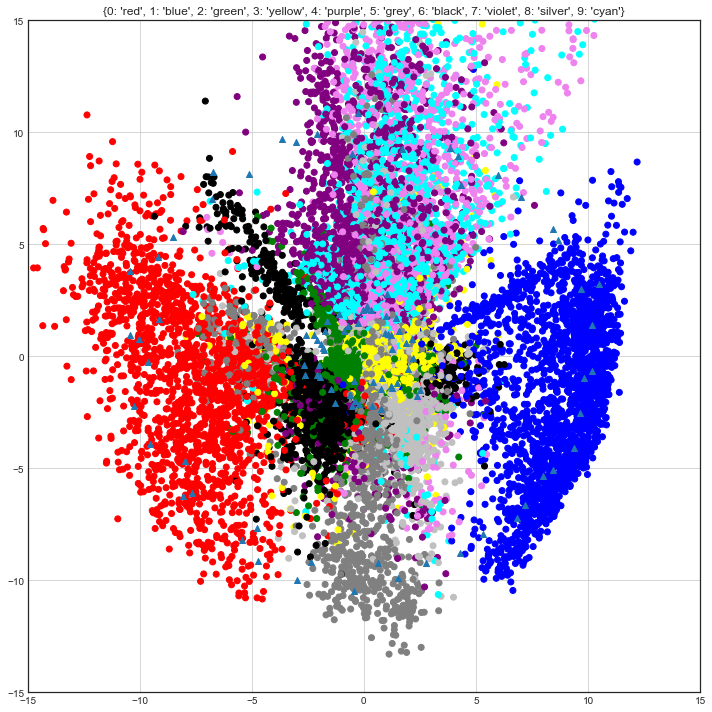

 iter: 250 batch: 19900 range: 1.1316221325515177e-22 recon cost: 0.1595381 zero cost: 0.53609407								 one  cost: 0.5281077 fake cost: 1.2336708456

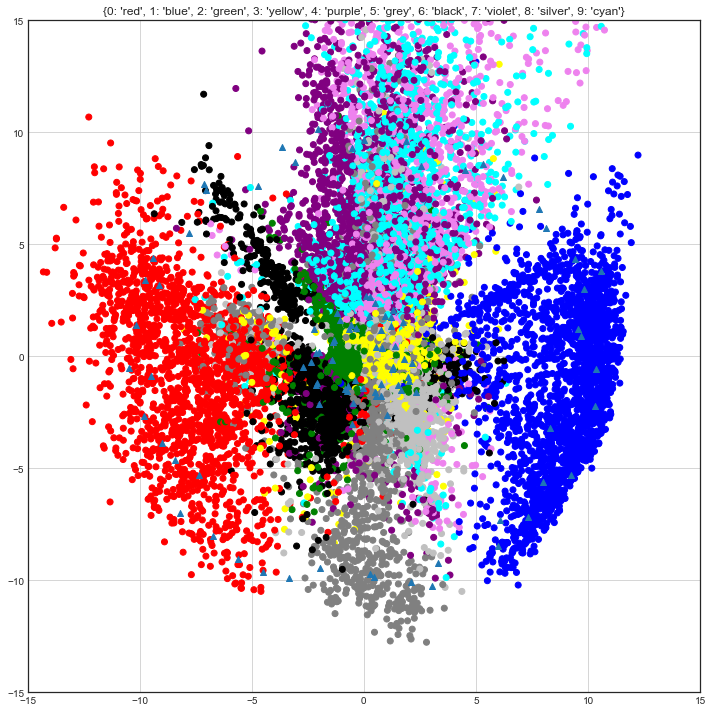

 iter: 275 batch: 19900 range: 1.9461422260171e-24 recon cost: 0.15780303 zero cost: 0.58854276								 one  cost: 0.44615543 fake cost: 1.2592067398

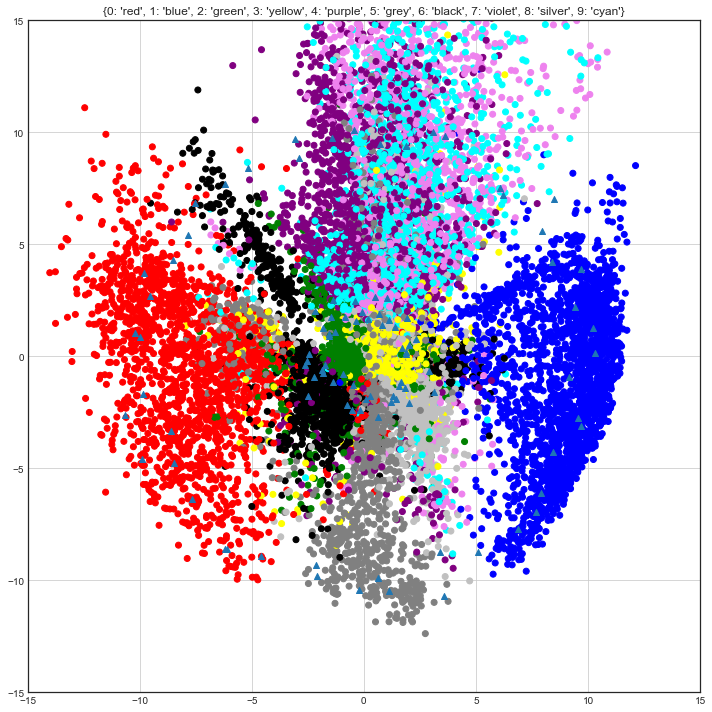

 iter: 300 batch: 19900 range: 3.346938394839468e-26 recon cost: 0.15669368 zero cost: 0.6117009								 one  cost: 0.39315808 fake cost: 1.331169277

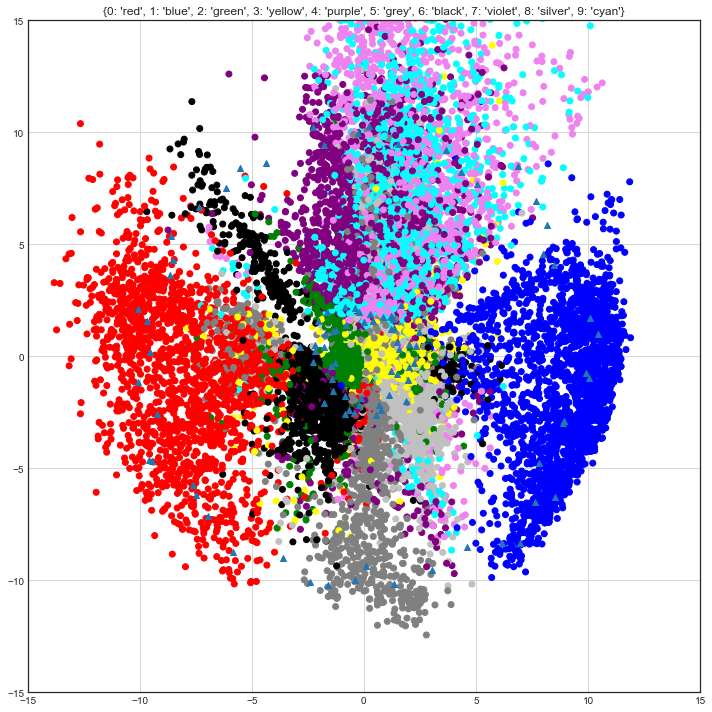

 iter: 325 batch: 19900 range: 5.756001010150308e-28 recon cost: 0.15655485 zero cost: 0.6307623								 one  cost: 0.46818802 fake cost: 1.417447221

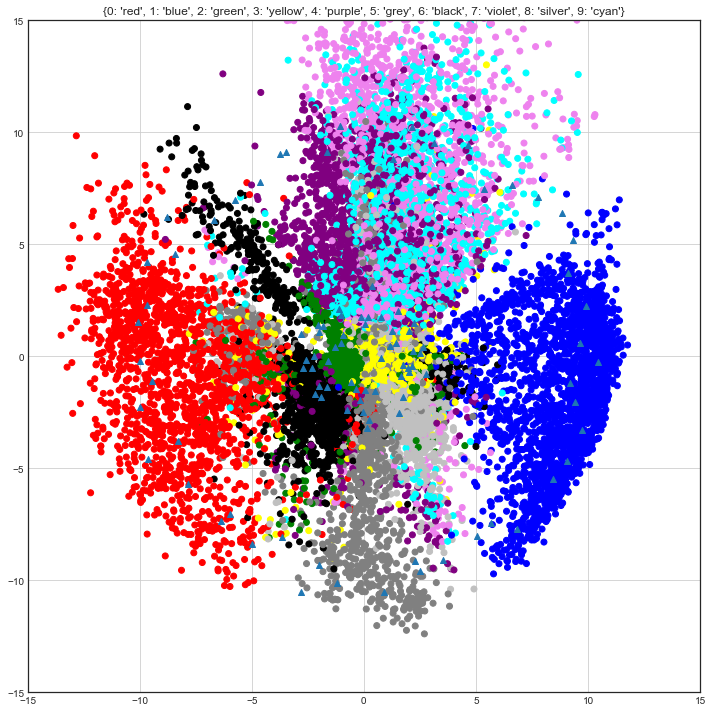

 iter: 350 batch: 19900 range: 9.899061088168155e-30 recon cost: 0.1557144 zero cost: 0.6247586								 one  cost: 0.40479037 fake cost: 1.5435226662

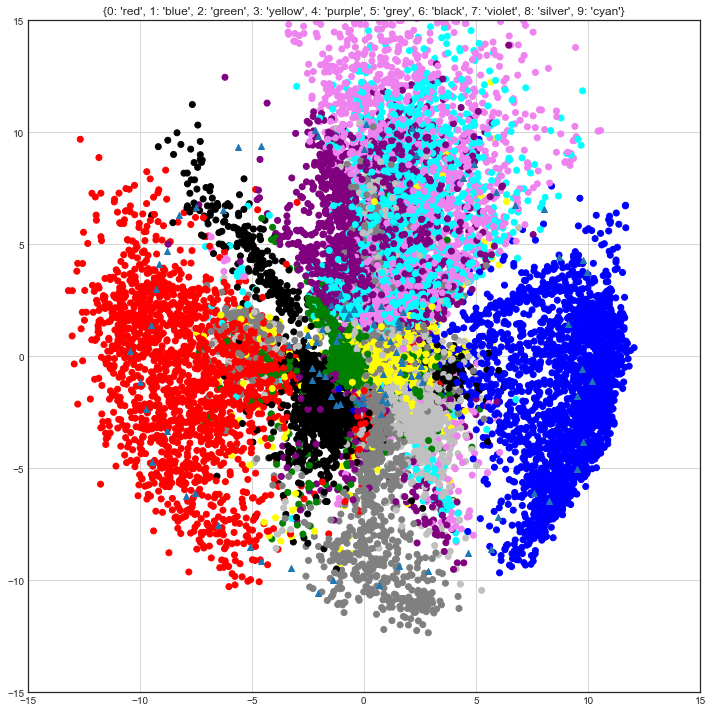

 iter: 375 batch: 19900 range: 1.70242170309706e-31 recon cost: 0.15478237 zero cost: 0.6800674								 one  cost: 0.40432063 fake cost: 1.5496808744

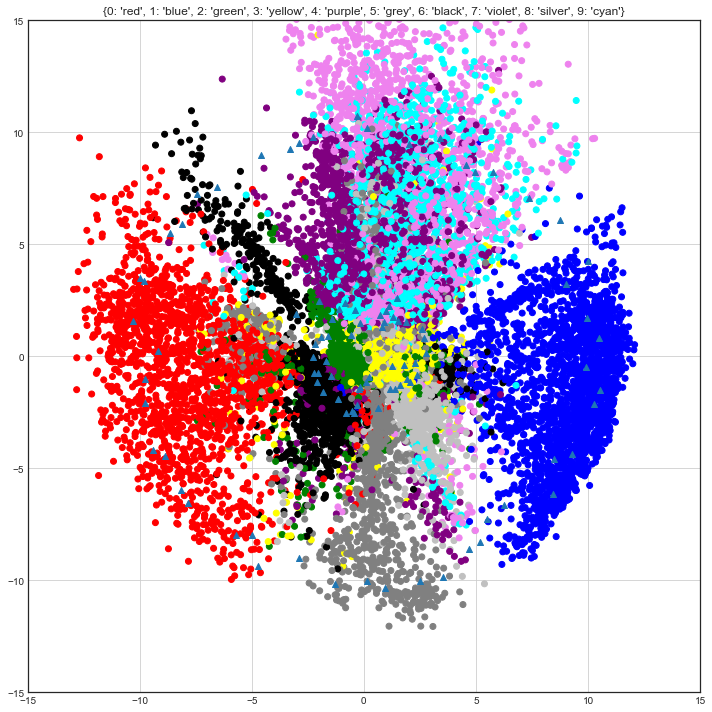

 iter: 400 batch: 19900 range: 2.9277924738135168e-33 recon cost: 0.15557443 zero cost: 0.7066844								 one  cost: 0.44999883 fake cost: 1.56447725

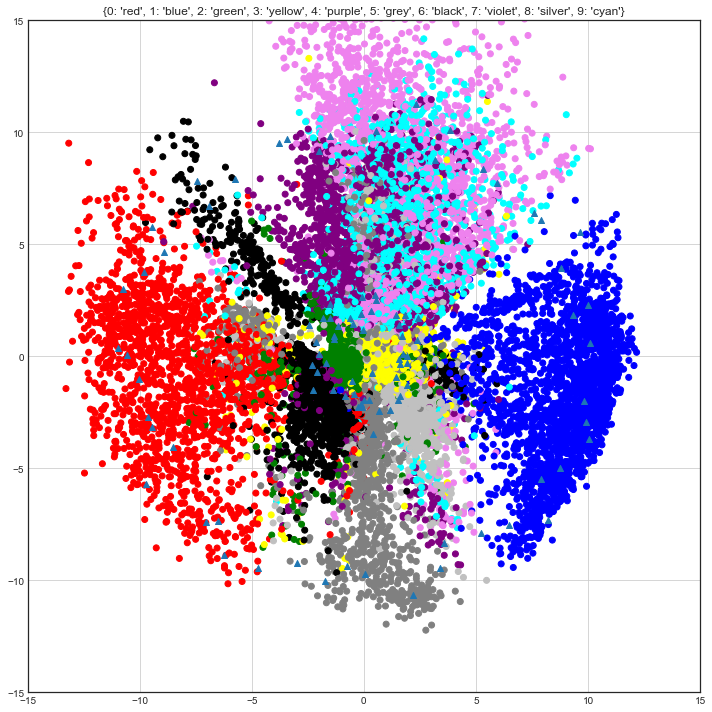

 iter: 425 batch: 19900 range: 5.035161825137024e-35 recon cost: 0.1538901 zero cost: 0.67458135								 one  cost: 0.37488857 fake cost: 1.650978481

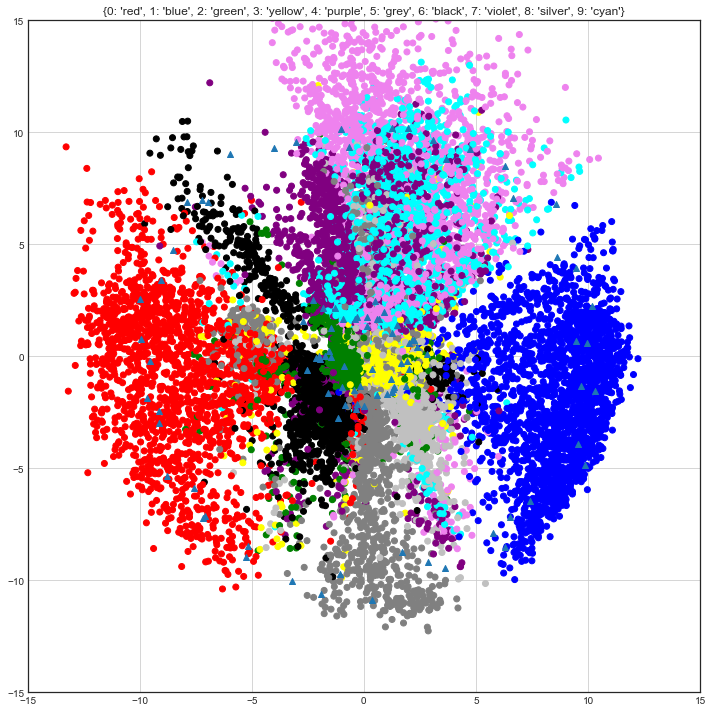

 iter: 450 batch: 19900 range: 8.65937556438026e-37 recon cost: 0.15371911 zero cost: 0.623016								 one  cost: 0.39389646 fake cost: 1.70103132564

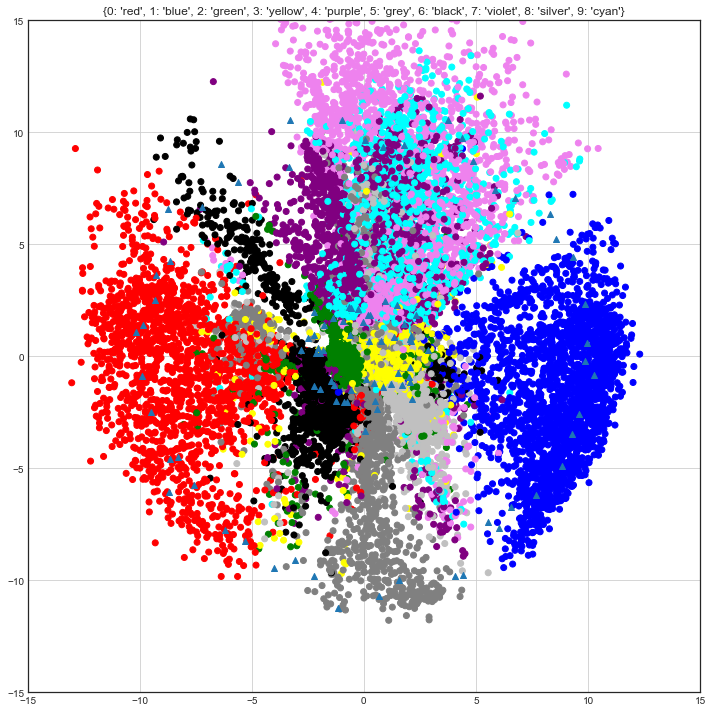

 iter: 475 batch: 19900 range: 1.4892229439506715e-38 recon cost: 0.15291214 zero cost: 0.63385826								 one  cost: 0.37447292 fake cost: 1.7200844

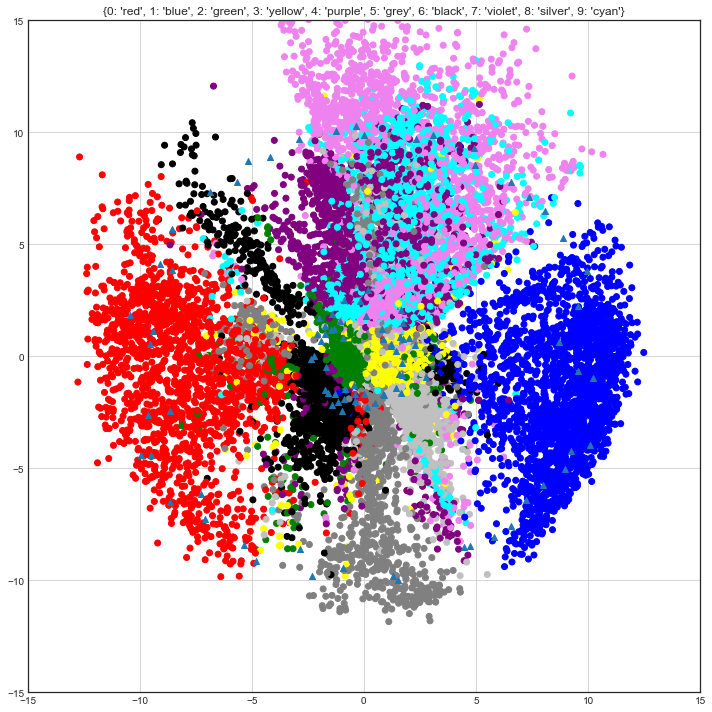

 iter: 500 batch: 19900 range: 2.5611373017608903e-40 recon cost: 0.1527368 zero cost: 0.62096924								 one  cost: 0.37368476 fake cost: 1.79532564

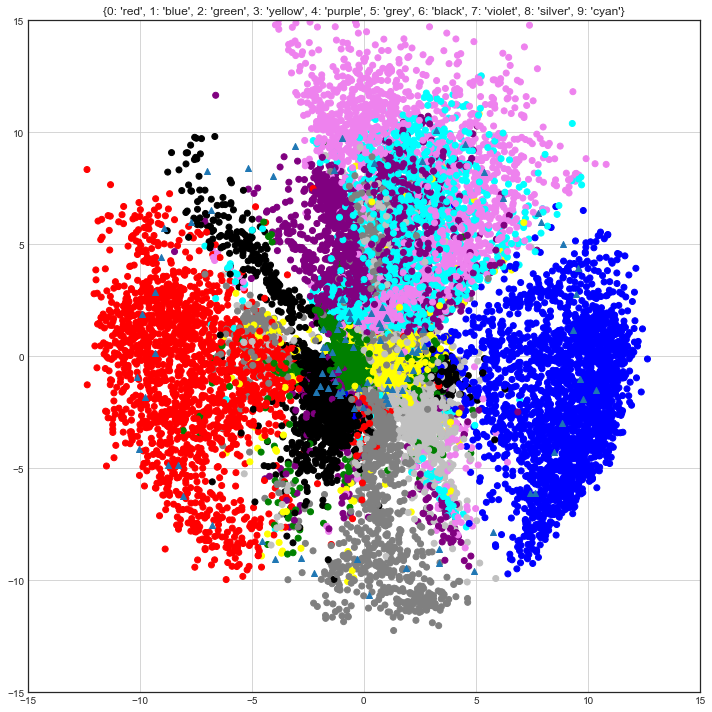

 iter: 525 batch: 19900 range: 4.404595232108058e-42 recon cost: 0.15275428 zero cost: 0.63205385								 one  cost: 0.38445285 fake cost: 1.74909382

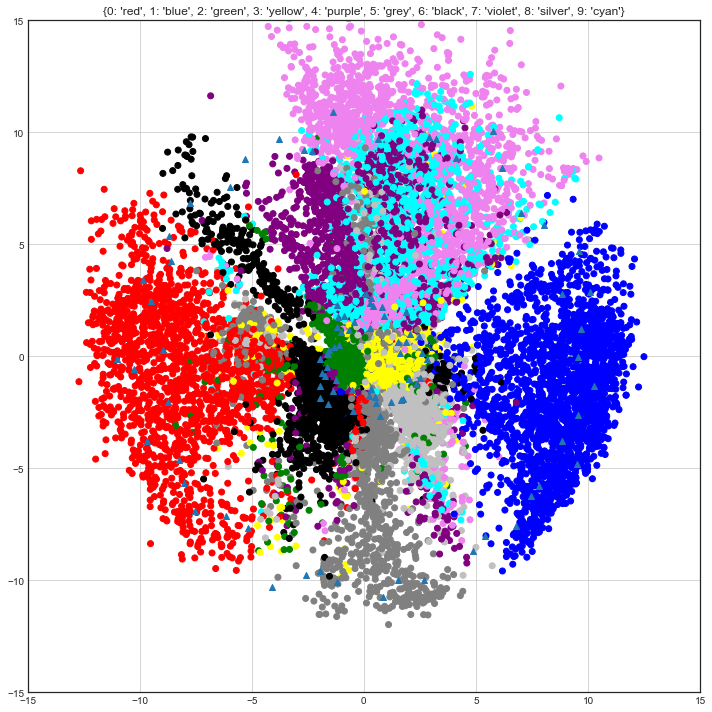

 iter: 550 batch: 19900 range: 7.574939127773589e-44 recon cost: 0.15211551 zero cost: 0.6203901								 one  cost: 0.383638 fake cost: 1.79051412984

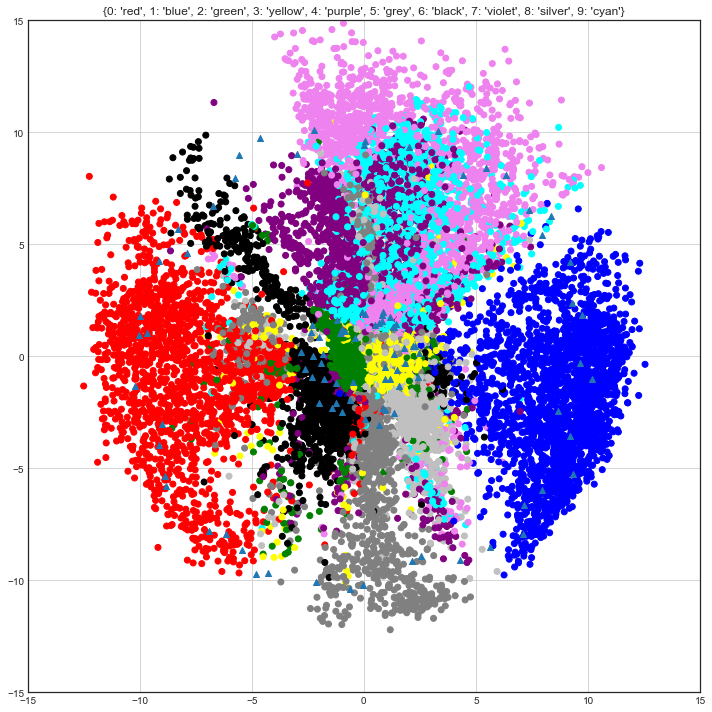

 iter: 575 batch: 19900 range: 1.3027236276149969e-45 recon cost: 0.15237598 zero cost: 0.64422524								 one  cost: 0.36592838 fake cost: 1.8125458

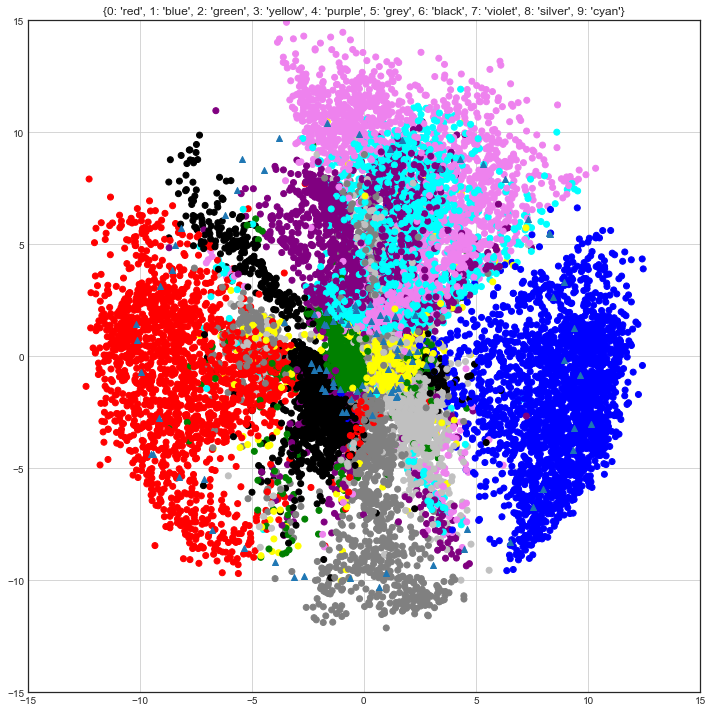

 iter: 600 batch: 19900 range: 2.24039932377012e-47 recon cost: 0.15177903 zero cost: 0.63516116								 one  cost: 0.40703586 fake cost: 1.830322425

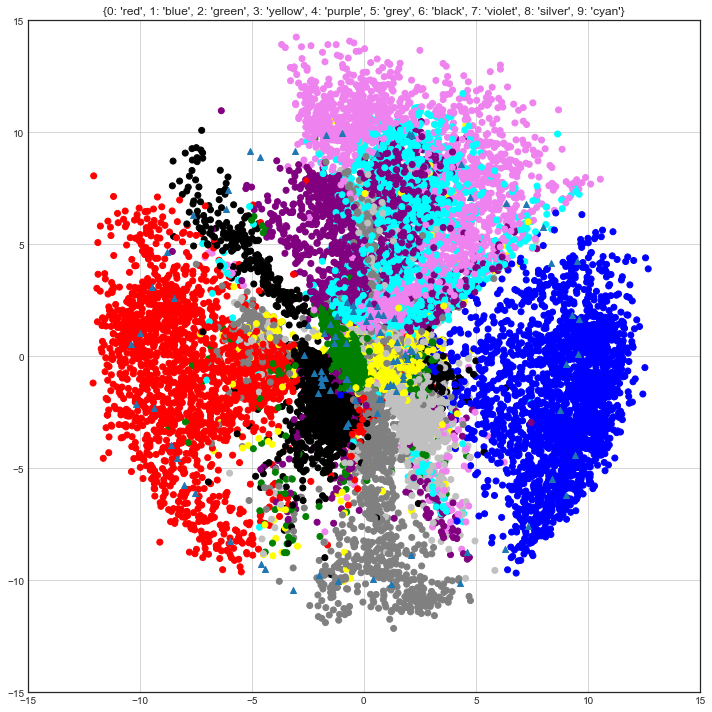

 iter: 625 batch: 19900 range: 3.852996156321369e-49 recon cost: 0.15220638 zero cost: 0.6533321								 one  cost: 0.43906388 fake cost: 1.810826834

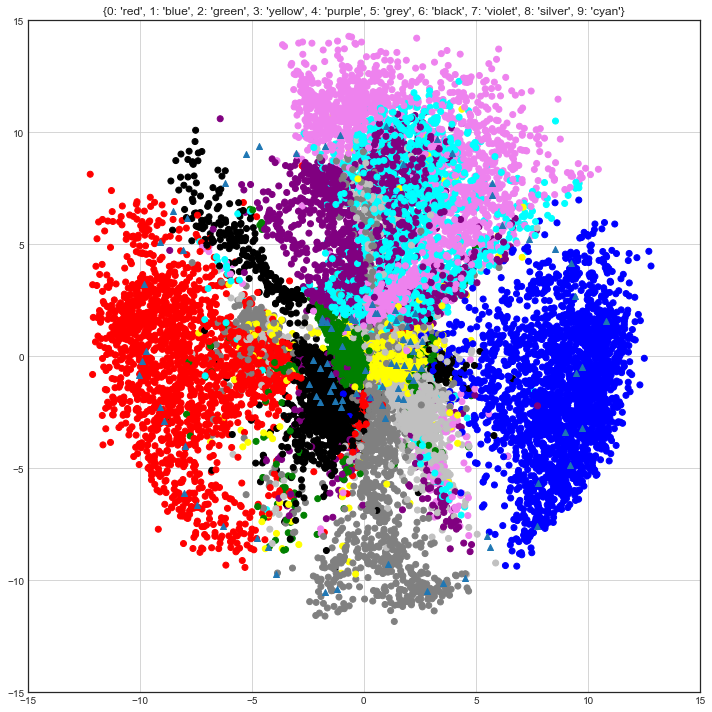

 iter: 650 batch: 19900 range: 6.626309525770279e-51 recon cost: 0.15202516 zero cost: 0.67344505								 one  cost: 0.3778762 fake cost: 1.789828383

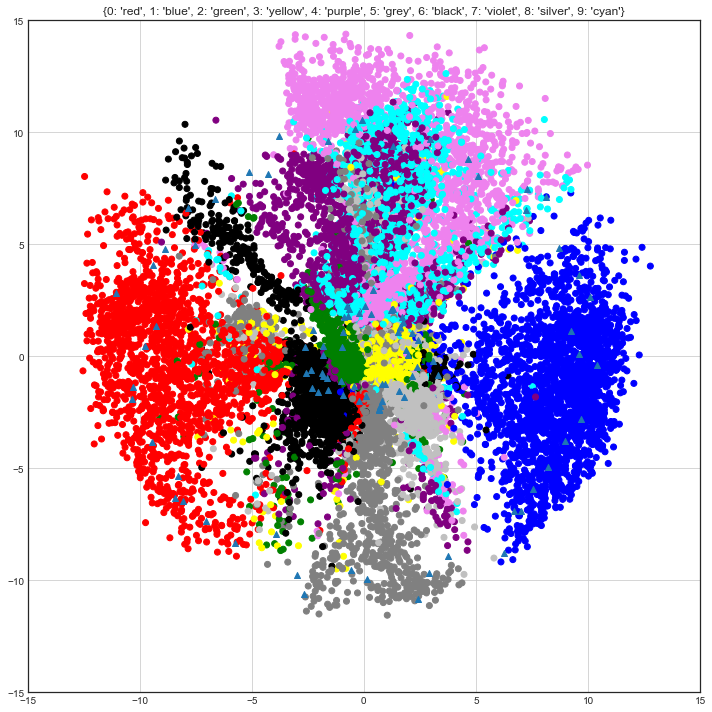

 iter: 675 batch: 19900 range: 1.1395801124607113e-52 recon cost: 0.15145566 zero cost: 0.67269754								 one  cost: 0.42023963 fake cost: 1.8115903

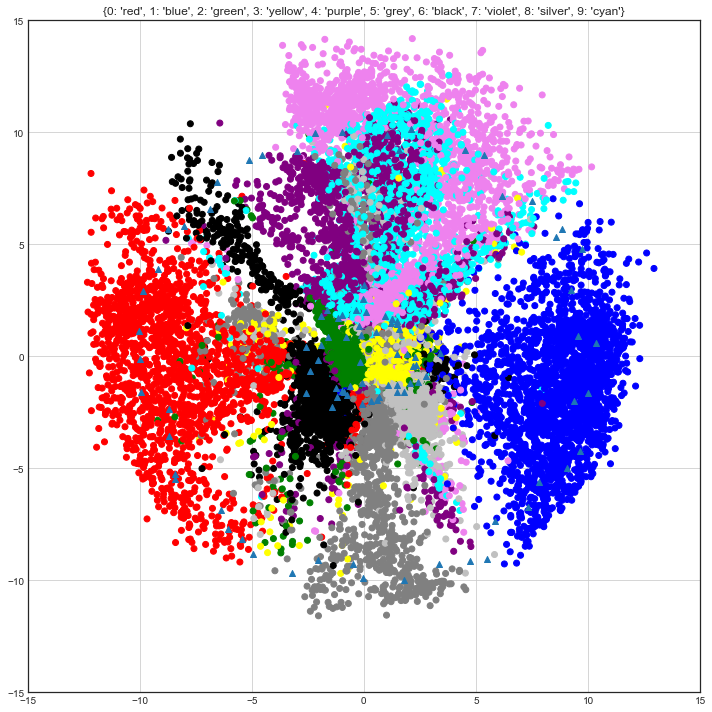

 iter: 700 batch: 19900 range: 1.9598282085457006e-54 recon cost: 0.15032622 zero cost: 0.6187427								 one  cost: 0.40007412 fake cost: 1.87624515

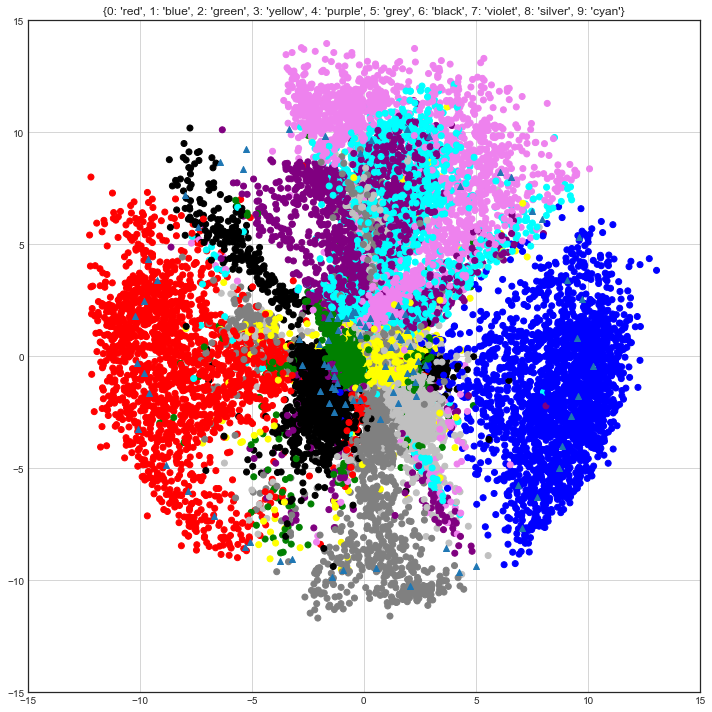

 iter: 725 batch: 19900 range: 3.3704752873562193e-56 recon cost: 0.15042378 zero cost: 0.6476404								 one  cost: 0.39589638 fake cost: 1.89462979

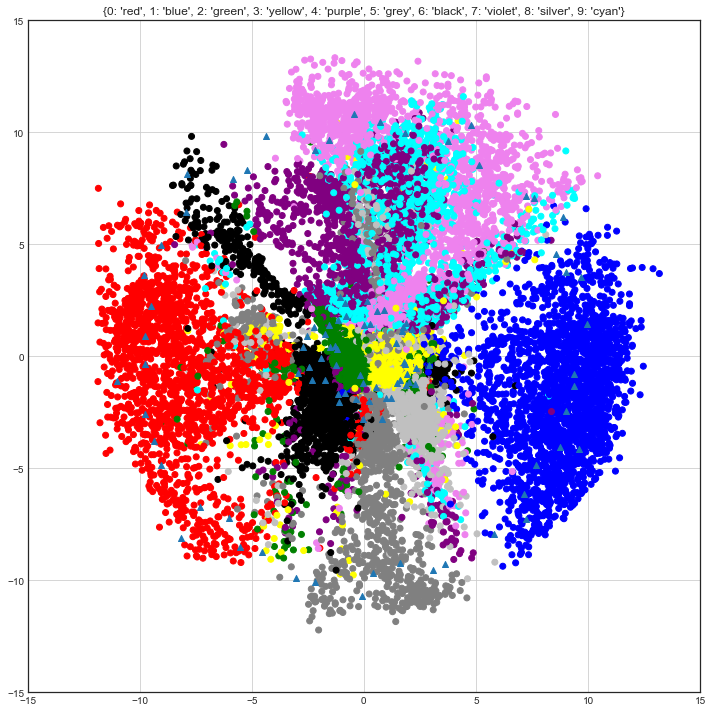

 iter: 750 batch: 19900 range: 5.7964793103518014e-58 recon cost: 0.1500187 zero cost: 0.64264315								 one  cost: 0.37856004 fake cost: 1.92160685

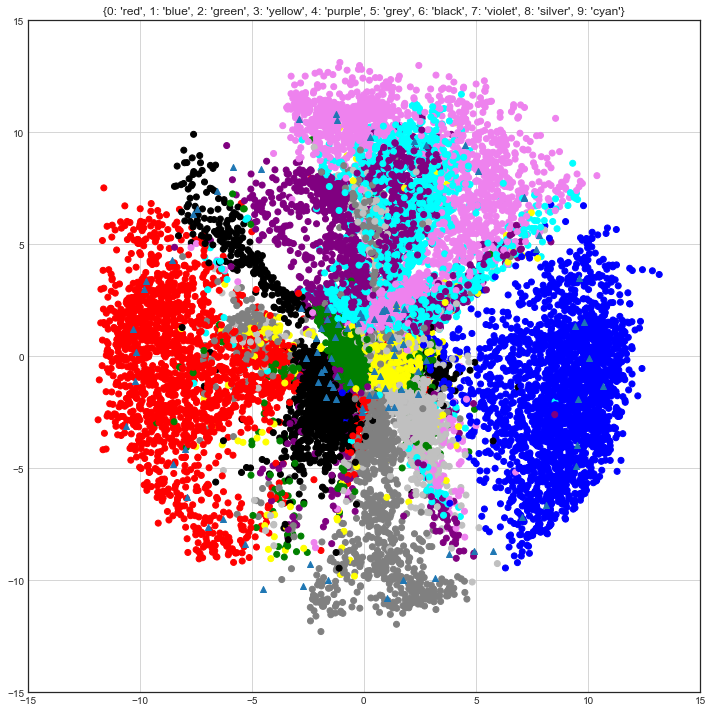

 iter: 775 batch: 19900 range: 9.968674899168743e-60 recon cost: 0.149516 zero cost: 0.6174688								 one  cost: 0.3993534 fake cost: 1.941996187825

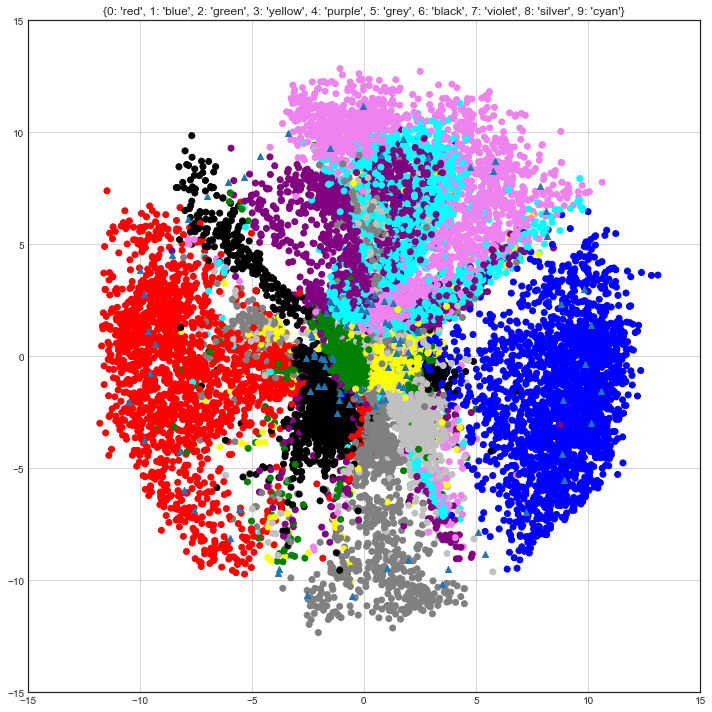

 iter: 800 batch: 19900 range: 1.7143937539438173e-61 recon cost: 0.15046248 zero cost: 0.6005873								 one  cost: 0.3734565 fake cost: 1.907944326

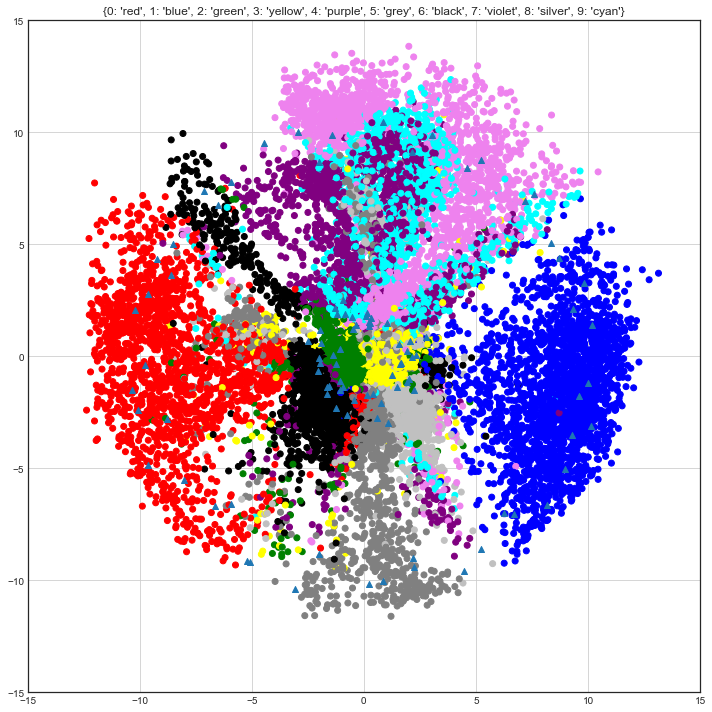

 iter: 825 batch: 19900 range: 2.948381779213866e-63 recon cost: 0.14881217 zero cost: 0.6128126								 one  cost: 0.3689083 fake cost: 1.9287452216

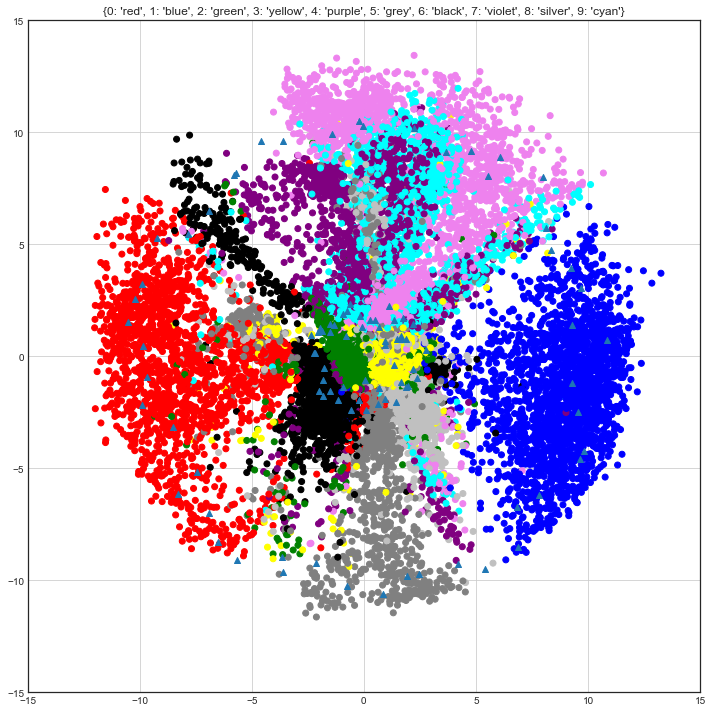

 iter: 850 batch: 19900 range: 5.070570921063446e-65 recon cost: 0.14822255 zero cost: 0.585002								 one  cost: 0.42214736 fake cost: 1.9789337855

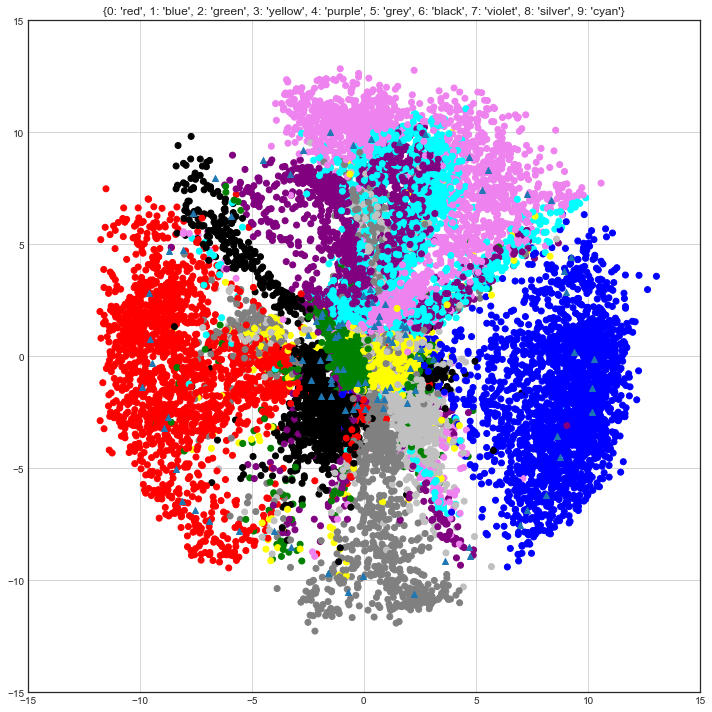

 iter: 875 batch: 19900 range: 8.720271454258379e-67 recon cost: 0.14872532 zero cost: 0.61757094								 one  cost: 0.45525822 fake cost: 1.90607896

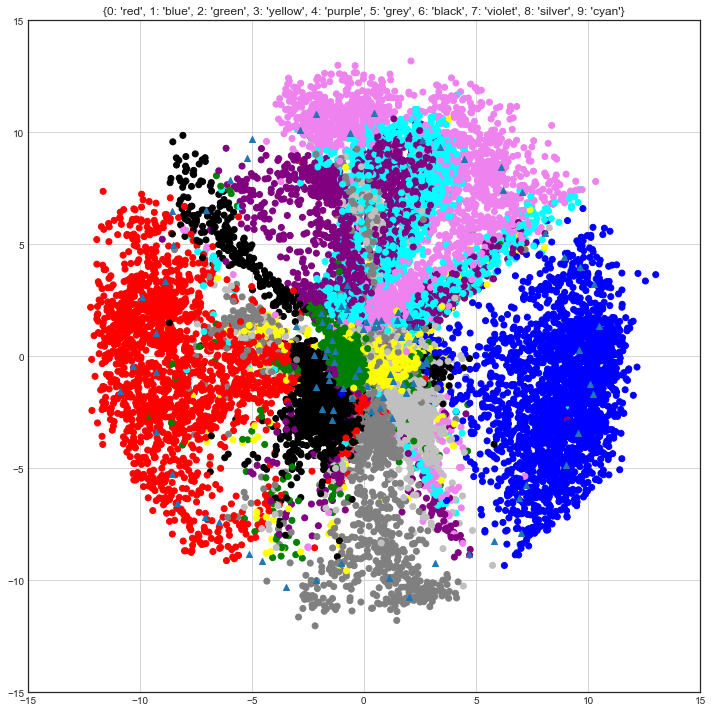

 iter: 900 batch: 19900 range: 1.4996957032997203e-68 recon cost: 0.14826204 zero cost: 0.5817509								 one  cost: 0.385722 fake cost: 1.9249388144

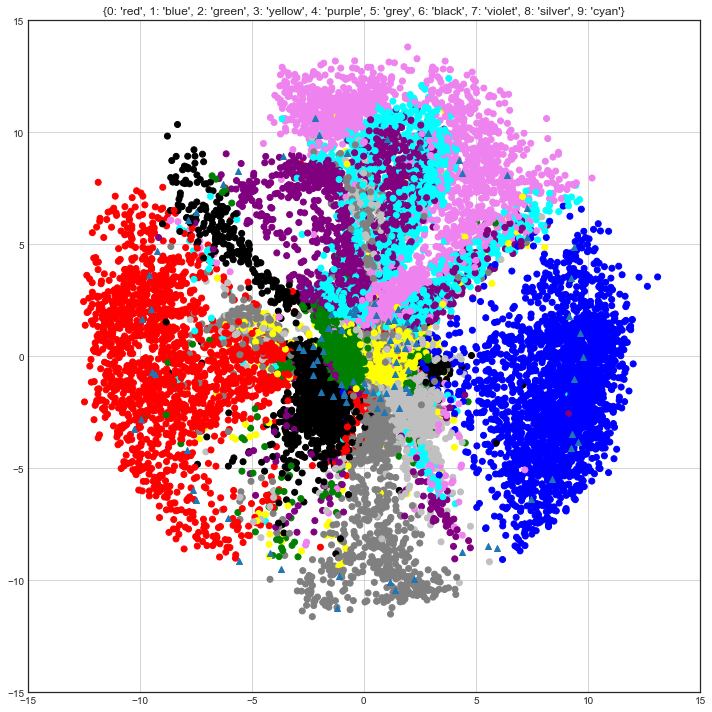

 iter: 925 batch: 19900 range: 2.579148154152177e-70 recon cost: 0.14827535 zero cost: 0.58207107								 one  cost: 0.395954 fake cost: 2.0121372416

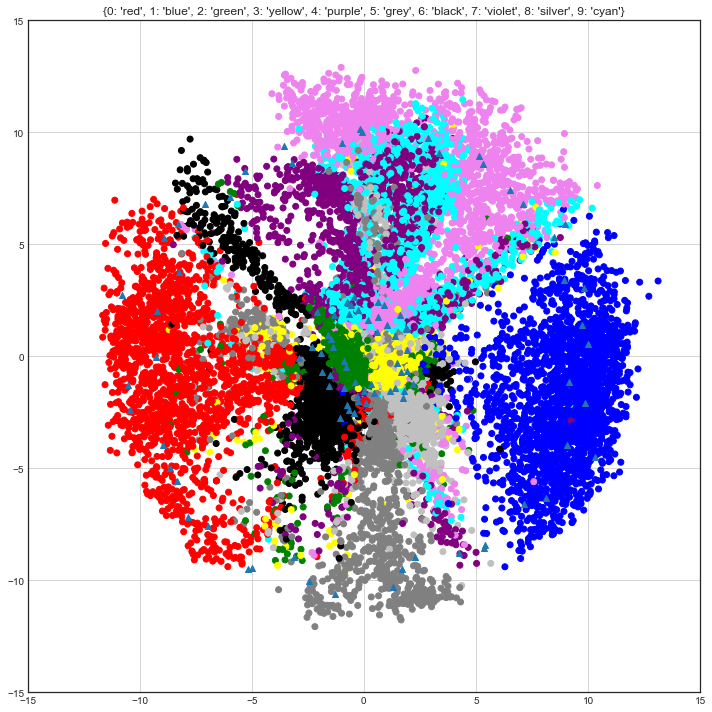

 iter: 950 batch: 19900 range: 4.4355699535782125e-72 recon cost: 0.1469956 zero cost: 0.56123674								 one  cost: 0.37594375 fake cost: 1.98559394

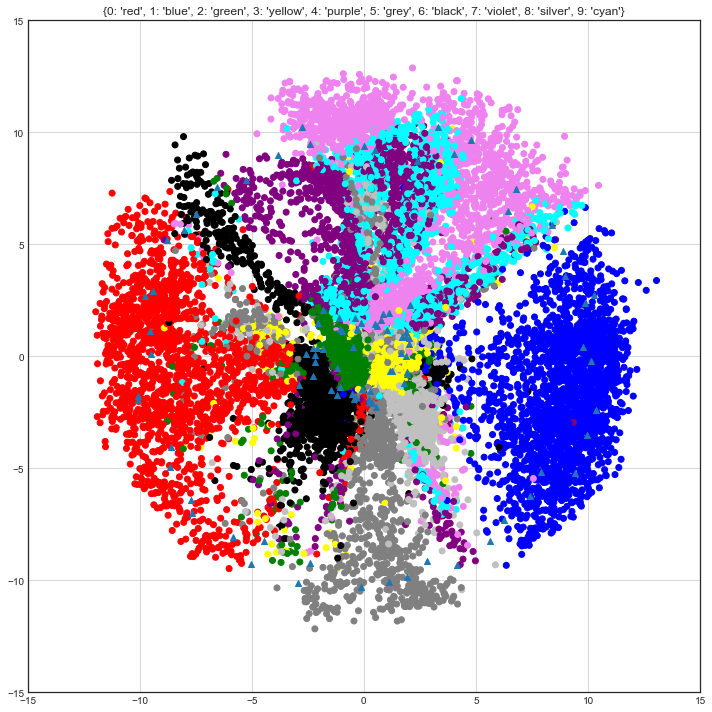

 iter: 975 batch: 19900 range: 7.62820886478047e-74 recon cost: 0.14705142 zero cost: 0.5580568								 one  cost: 0.4071433 fake cost: 1.99121436325

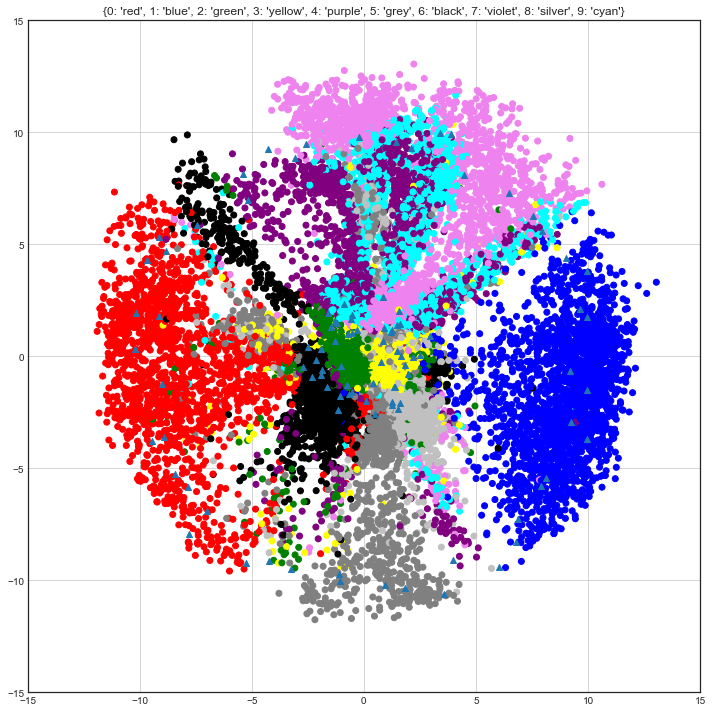

 iter: 1000 batch: 19900 range: 1.3118848556942112e-75 recon cost: 0.14647764 zero cost: 0.5782677								 one  cost: 0.38310286 fake cost: 1.96234484

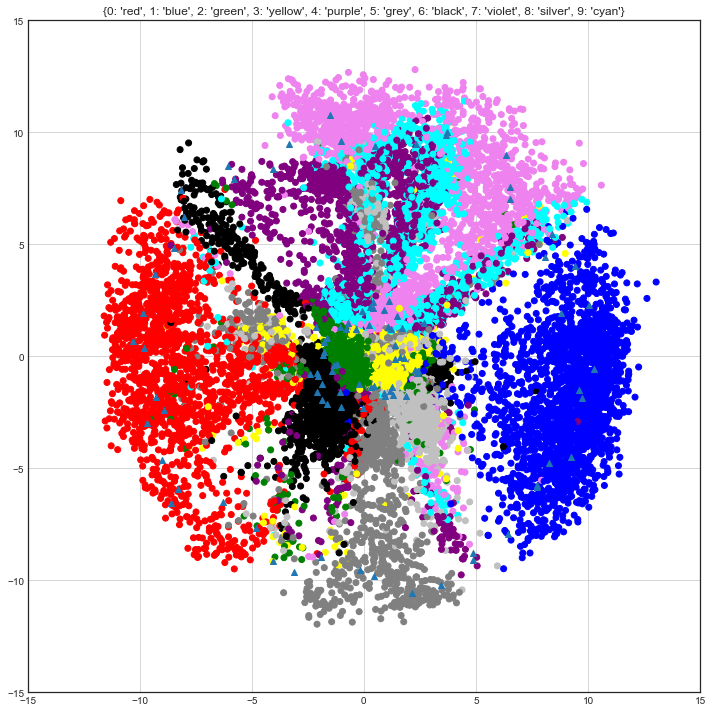

 iter: 1025 batch: 19900 range: 2.256154629622023e-77 recon cost: 0.14628069 zero cost: 0.5723237								 one  cost: 0.39242896 fake cost: 1.967026147

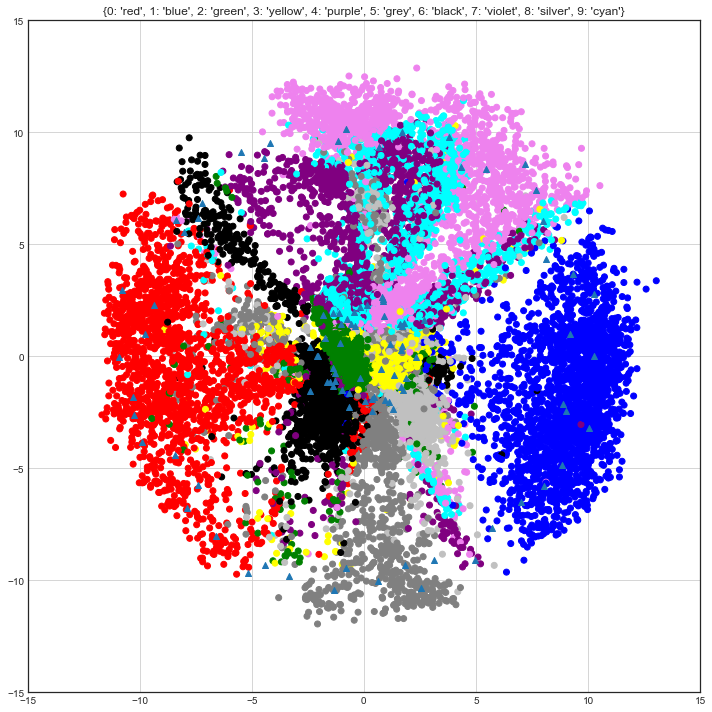

 iter: 1050 batch: 19900 range: 3.880091831741808e-79 recon cost: 0.14655873 zero cost: 0.55189204								 one  cost: 0.43523276 fake cost: 1.96909985

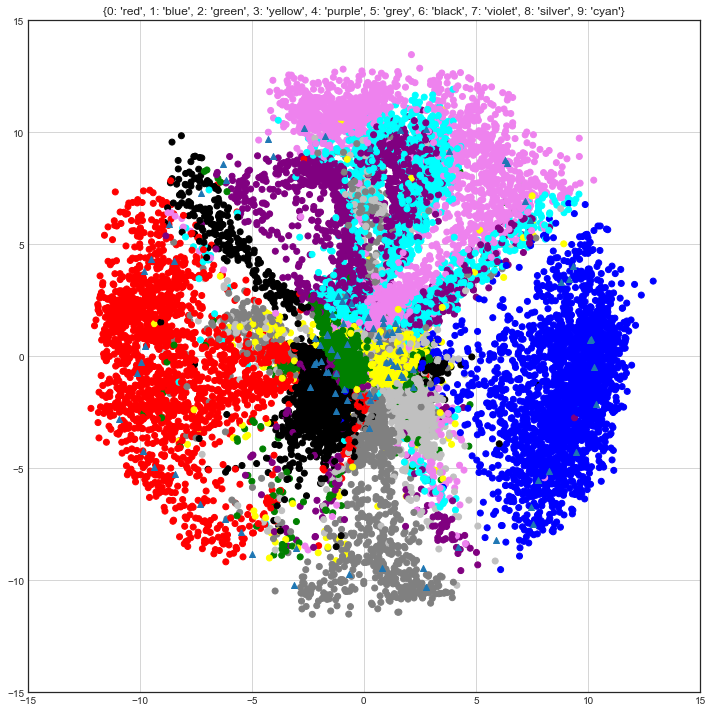

 iter: 1075 batch: 19900 range: 6.672908153140064e-81 recon cost: 0.14683126 zero cost: 0.6177182								 one  cost: 0.35587043 fake cost: 1.974473949

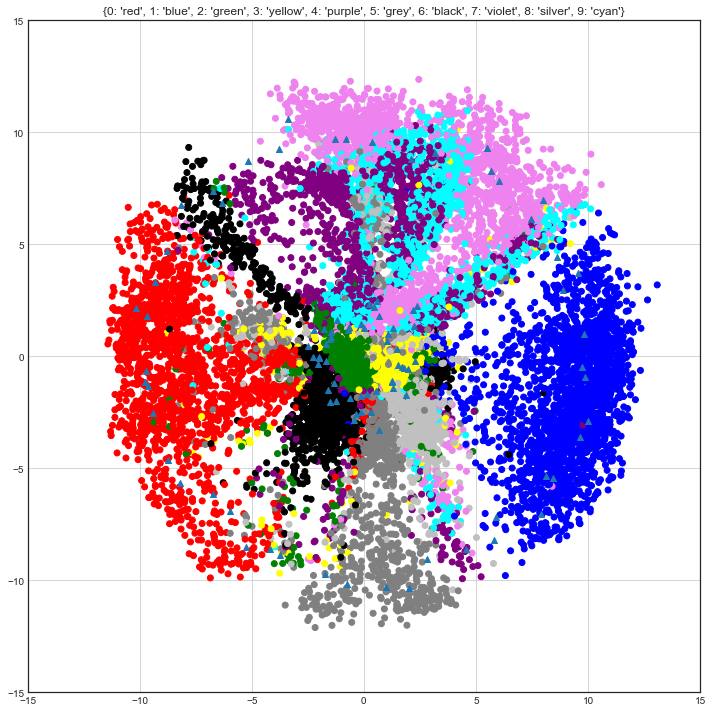

 iter: 1100 batch: 19900 range: 1.1475940557895057e-82 recon cost: 0.14570673 zero cost: 0.55030805								 one  cost: 0.41923538 fake cost: 1.9447258

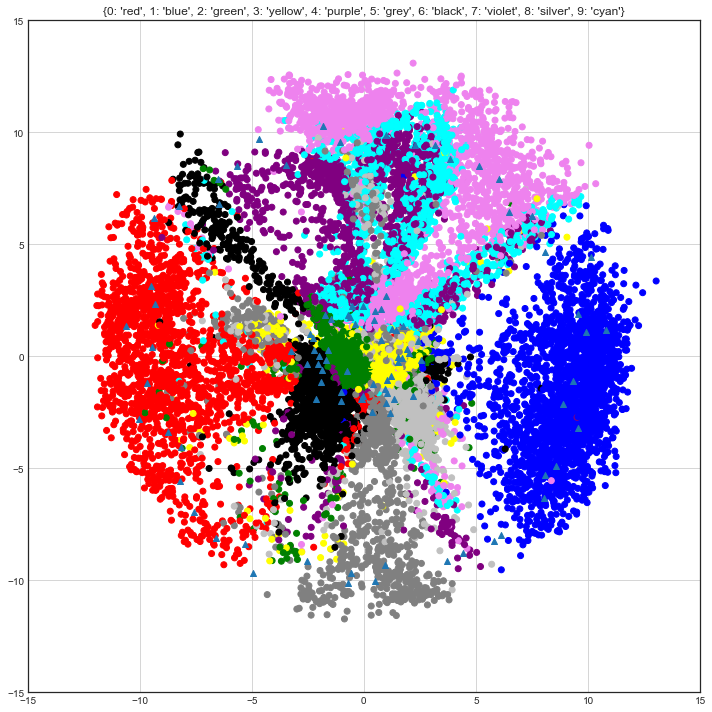

 iter: 1125 batch: 19900 range: 1.9736104358991983e-84 recon cost: 0.14553791 zero cost: 0.5431606								 one  cost: 0.39693776 fake cost: 2.00629433

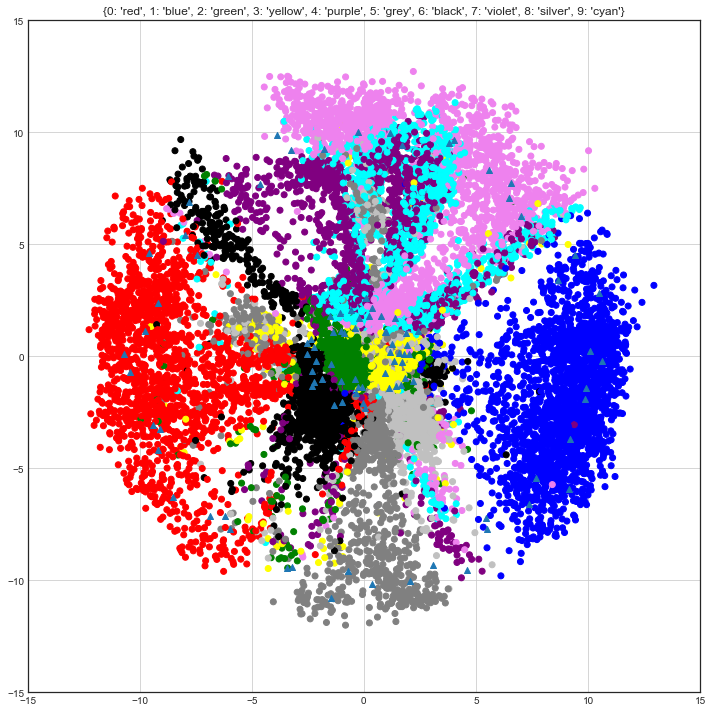

 iter: 1150 batch: 19900 range: 3.394177699892756e-86 recon cost: 0.14518651 zero cost: 0.572517								 one  cost: 0.42470524 fake cost: 1.9374764631

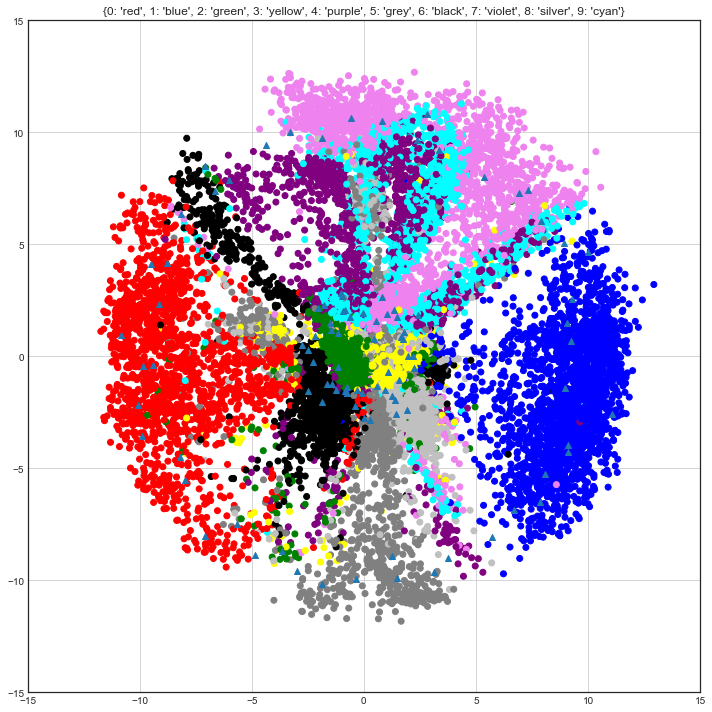

 iter: 1175 batch: 19900 range: 5.837242268735997e-88 recon cost: 0.1450018 zero cost: 0.539838								 one  cost: 0.43704402 fake cost: 1.96824635755

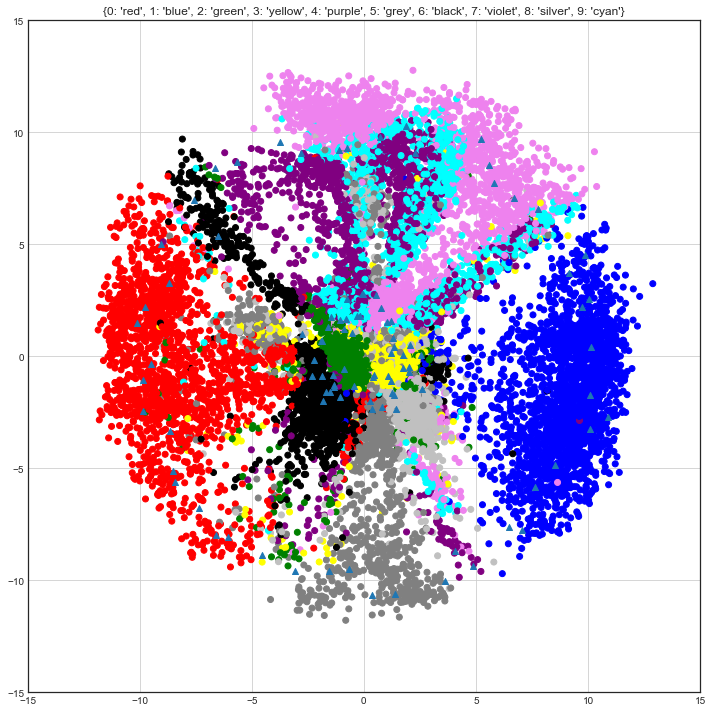

 iter: 1200 batch: 19900 range: 1.0038778259899225e-89 recon cost: 0.1452742 zero cost: 0.5511015								 one  cost: 0.4382929 fake cost: 1.9079573474

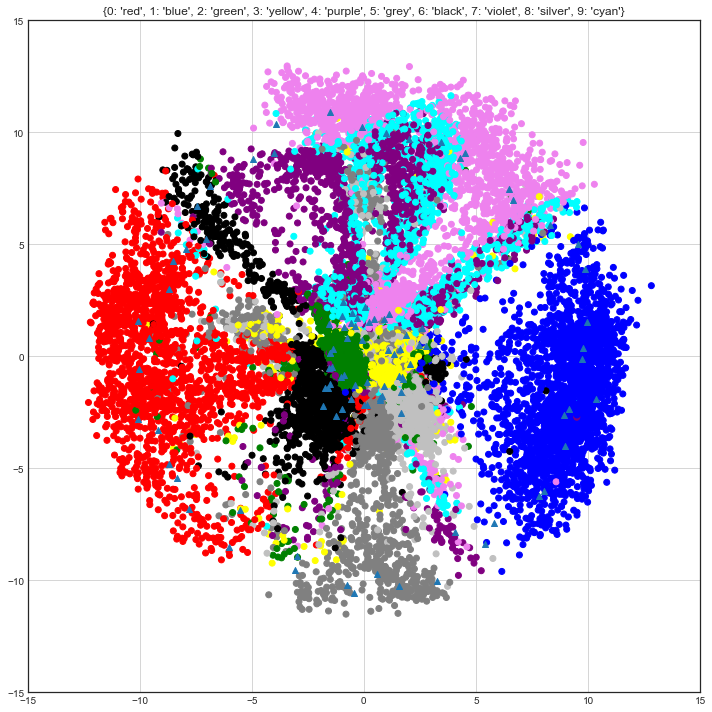

 iter: 1225 batch: 19900 range: 1.726449996622253e-91 recon cost: 0.14478287 zero cost: 0.54179615								 one  cost: 0.44405326 fake cost: 1.92279783

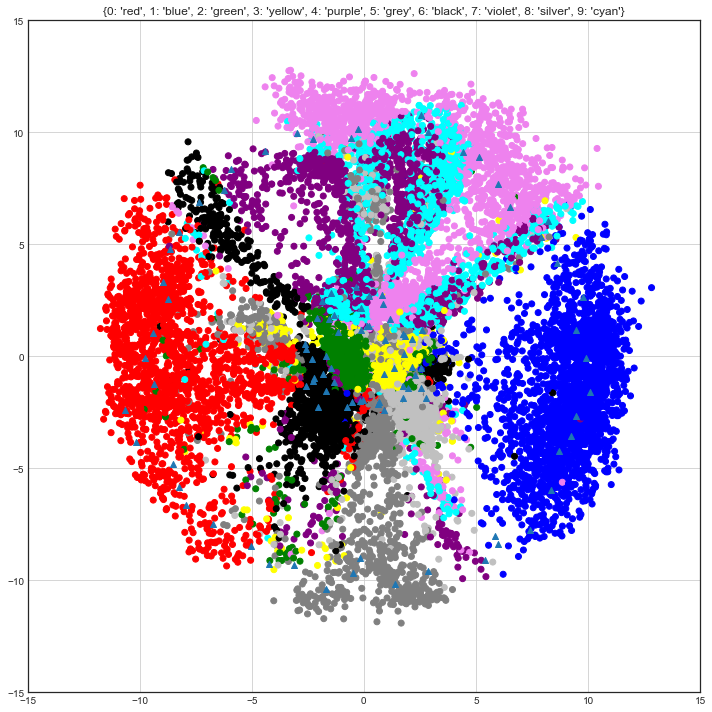

 iter: 1250 batch: 19900 range: 2.9691158761254457e-93 recon cost: 0.14599659 zero cost: 0.52996165								 one  cost: 0.39303386 fake cost: 1.9402102

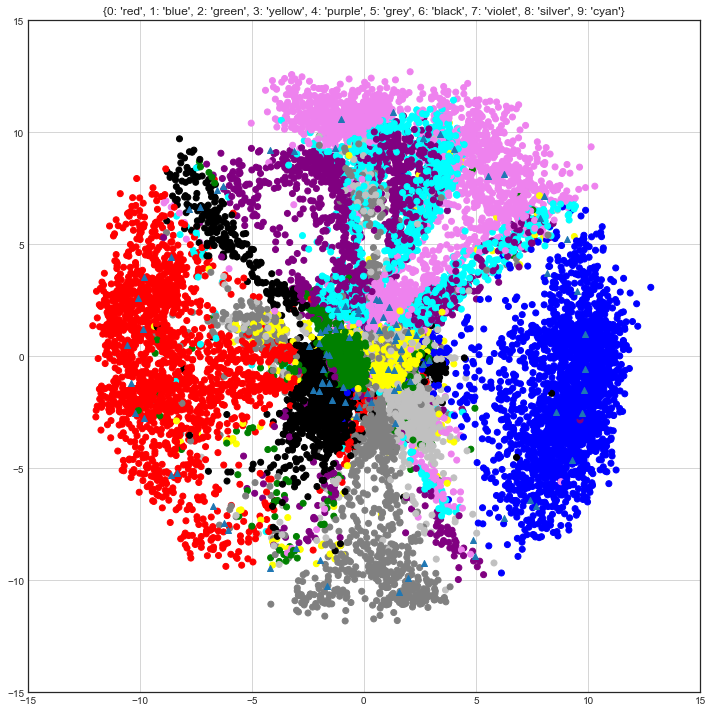

 iter: 1275 batch: 19900 range: 5.1062290266777075e-95 recon cost: 0.14446554 zero cost: 0.59023714								 one  cost: 0.41092324 fake cost: 1.8836554

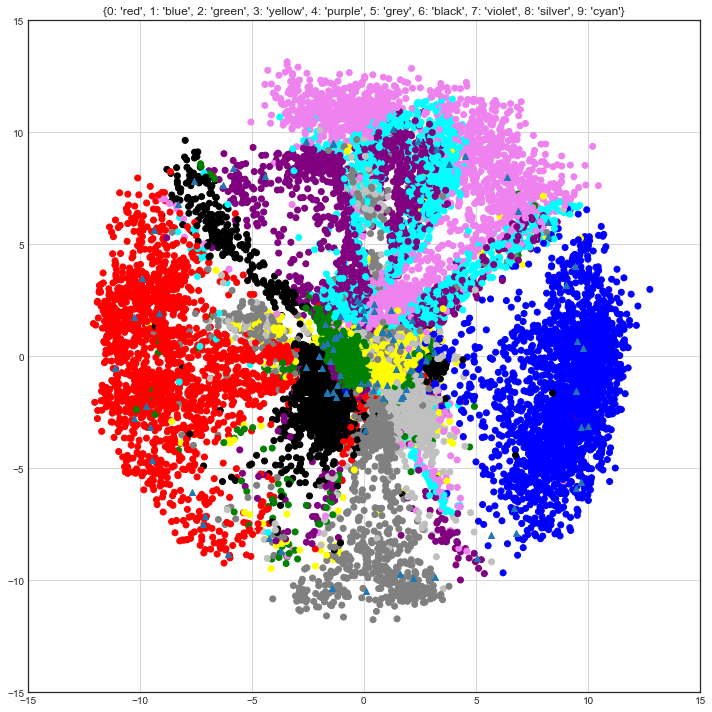

 iter: 1300 batch: 19900 range: 8.781595586262776e-97 recon cost: 0.14434567 zero cost: 0.544422								 one  cost: 0.39149916 fake cost: 1.9499837832

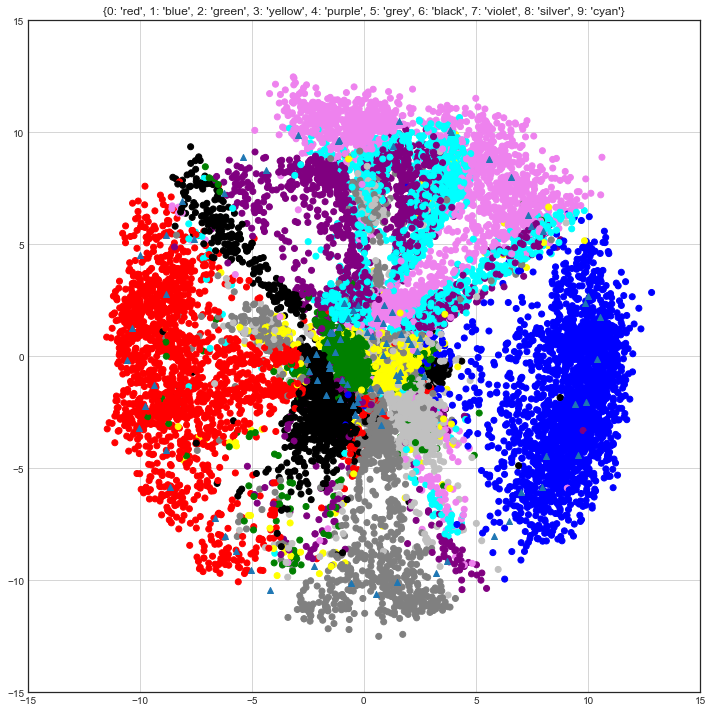

 iter: 1325 batch: 19900 range: 1.510242110915353e-98 recon cost: 0.14460234 zero cost: 0.5758914								 one  cost: 0.37005842 fake cost: 1.829499886

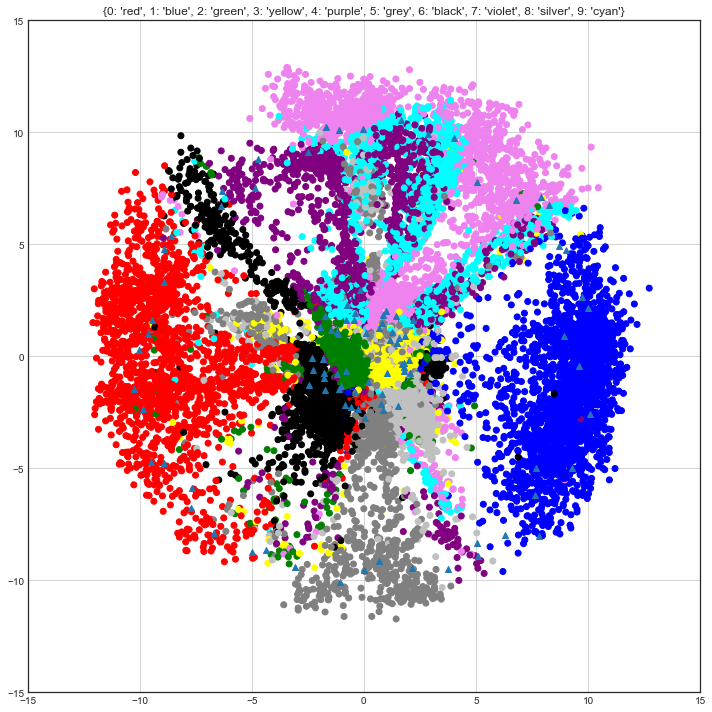

 iter: 1350 batch: 19900 range: 2.597285665431931e-100 recon cost: 0.14406255 zero cost: 0.54863405								 one  cost: 0.40923727 fake cost: 1.88392787

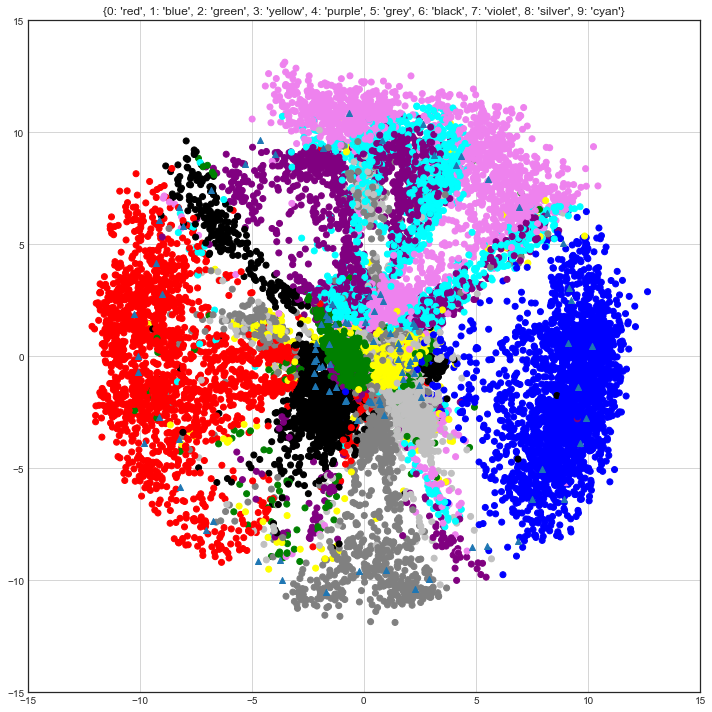

 iter: 1375 batch: 19900 range: 4.466762500596359e-102 recon cost: 0.14452057 zero cost: 0.5561009								 one  cost: 0.37608284 fake cost: 1.832412262

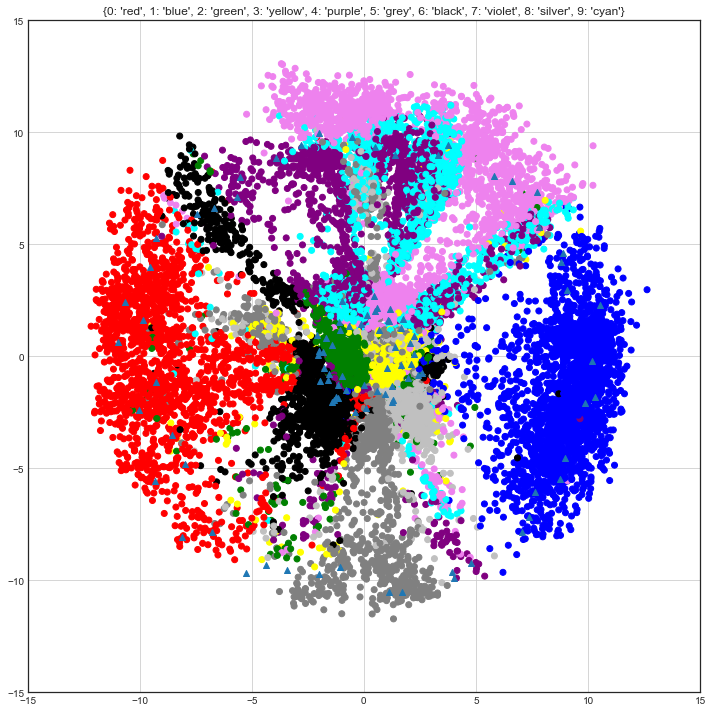

 iter: 1400 batch: 19900 range: 7.681853214022884e-104 recon cost: 0.14348368 zero cost: 0.5573181								 one  cost: 0.40268248 fake cost: 1.906285992

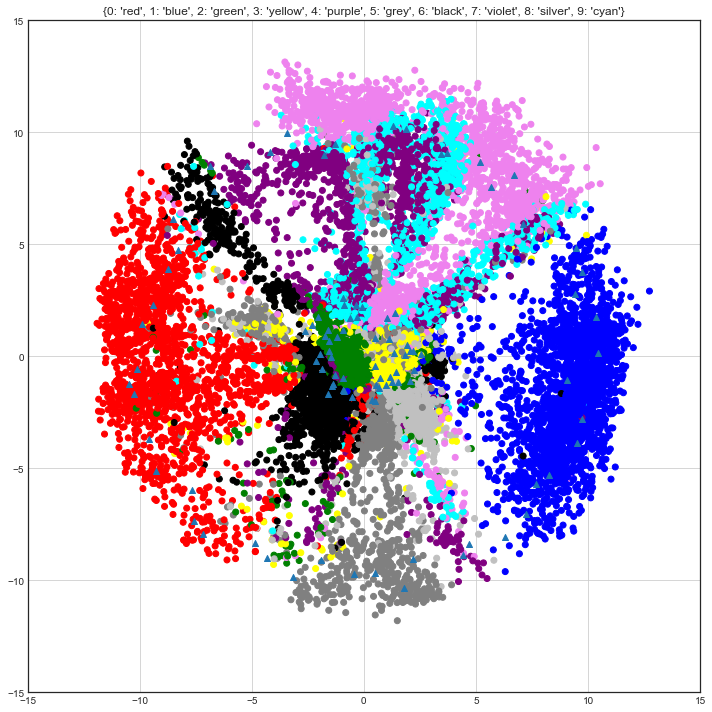

 iter: 1425 batch: 19900 range: 1.321110508873376e-105 recon cost: 0.14403607 zero cost: 0.5578847								 one  cost: 0.40014303 fake cost: 1.921348244

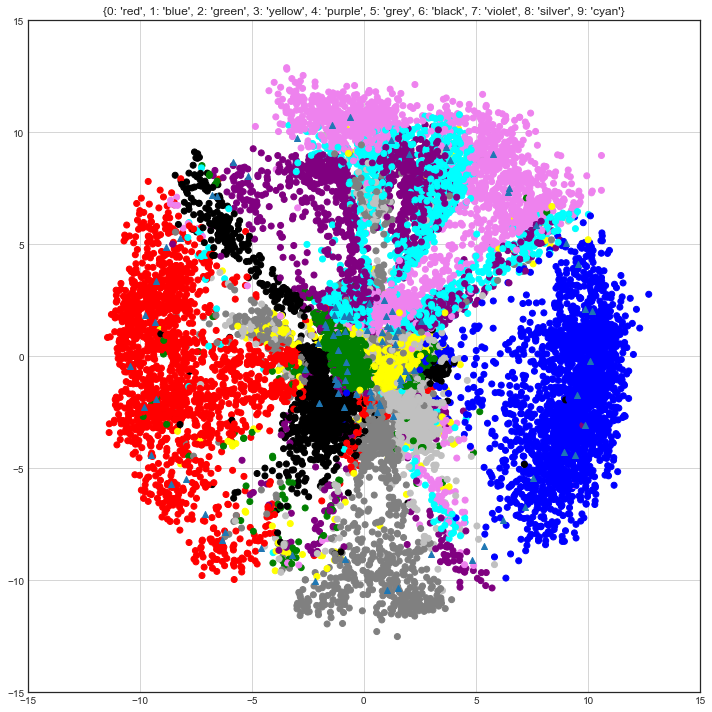

 iter: 1450 batch: 19900 range: 2.272020732535794e-107 recon cost: 0.1430965 zero cost: 0.5596896								 one  cost: 0.380081 fake cost: 1.869898712759

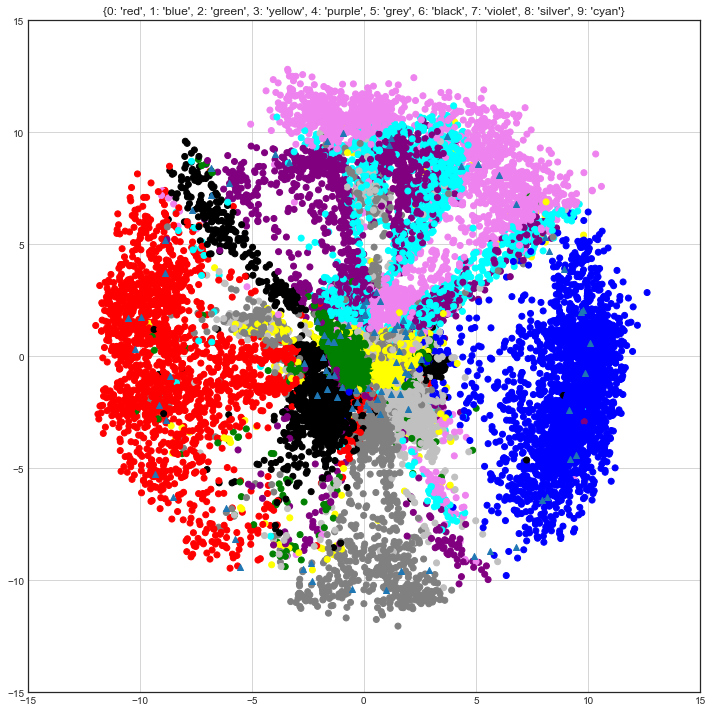

 iter: 1475 batch: 19900 range: 3.907378053842468e-109 recon cost: 0.14285268 zero cost: 0.55567056								 one  cost: 0.40337688 fake cost: 1.88753331

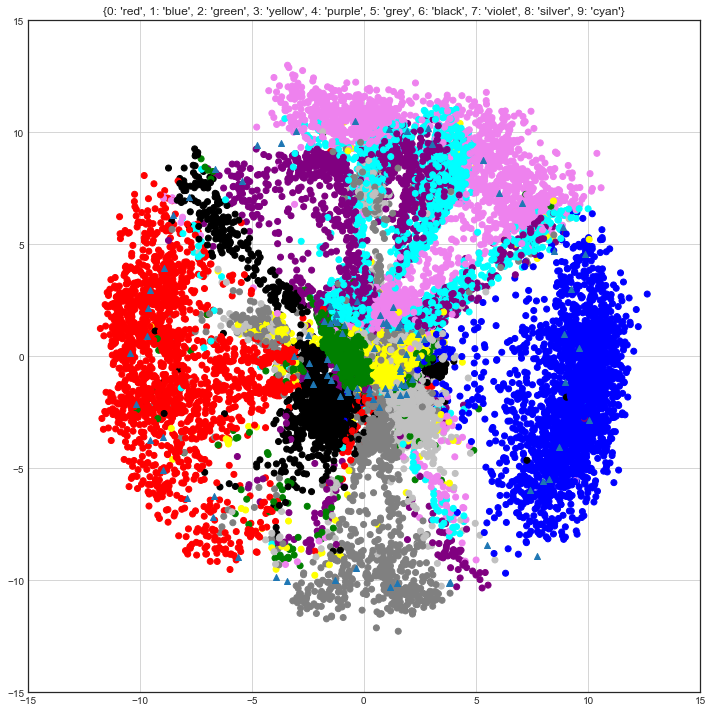

 iter: 1500 batch: 19900 range: 6.719834479067292e-111 recon cost: 0.14378265 zero cost: 0.53189075								 one  cost: 0.39114302 fake cost: 1.86495052

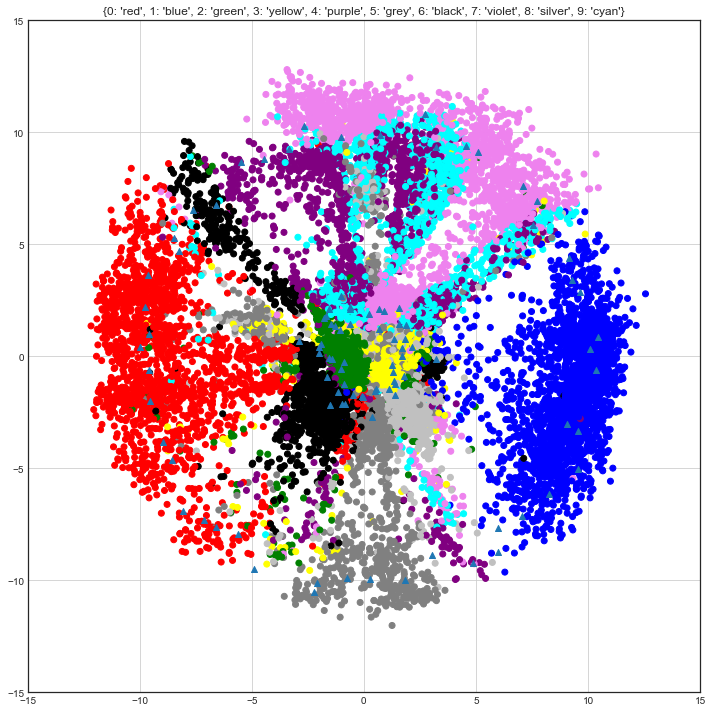

 iter: 1525 batch: 19900 range: 1.155664356093098e-112 recon cost: 0.14317739 zero cost: 0.56910485								 one  cost: 0.43119496 fake cost: 1.84241772

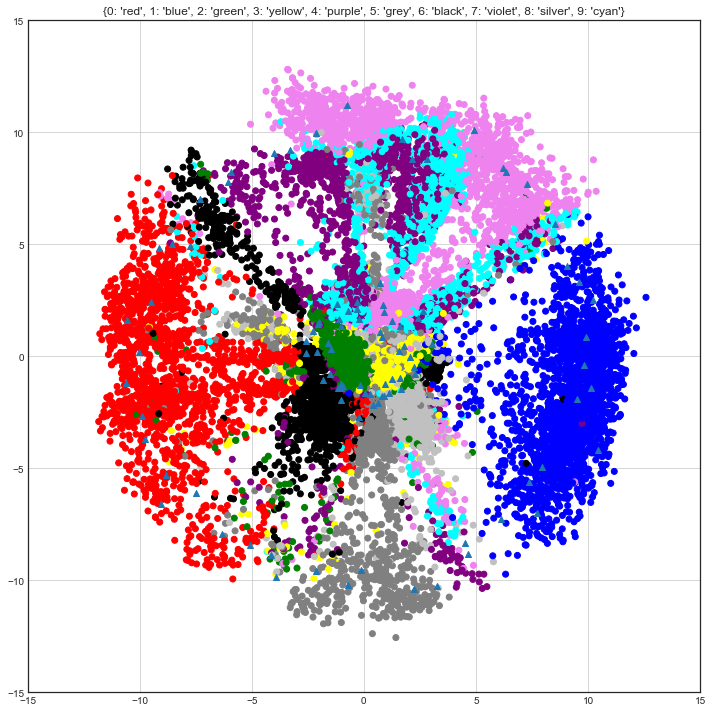

 iter: 1550 batch: 19900 range: 1.9874895849063385e-114 recon cost: 0.14263694 zero cost: 0.5610334								 one  cost: 0.45102227 fake cost: 1.81602792

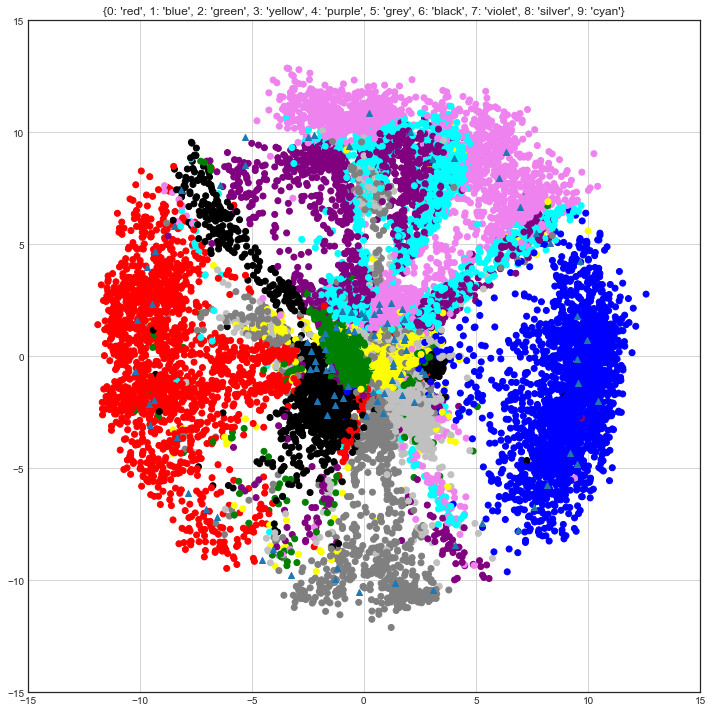

 iter: 1575 batch: 19900 range: 3.418046796446281e-116 recon cost: 0.14227083 zero cost: 0.57700056								 one  cost: 0.40220407 fake cost: 1.79298635

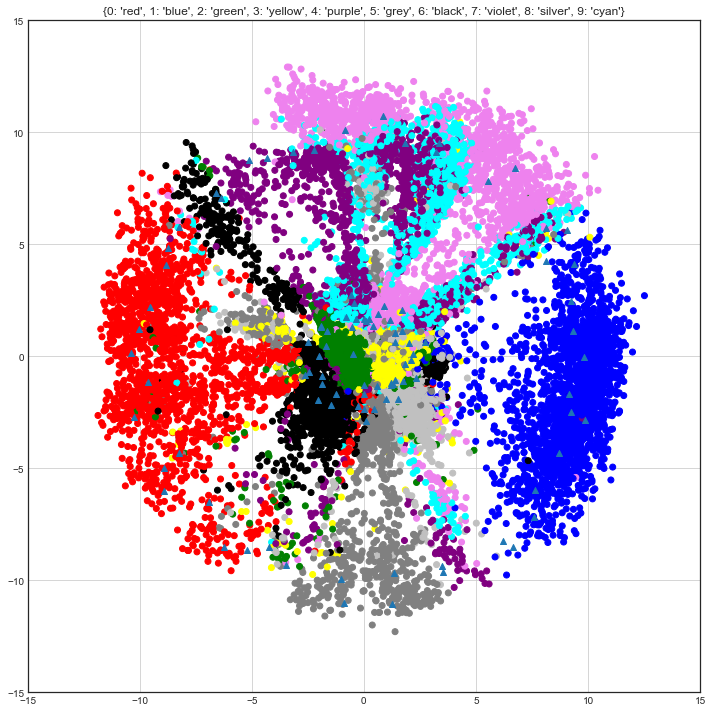

 iter: 1600 batch: 19900 range: 5.8782918871231475e-118 recon cost: 0.1421577 zero cost: 0.565555								 one  cost: 0.39828256 fake cost: 1.8097124925

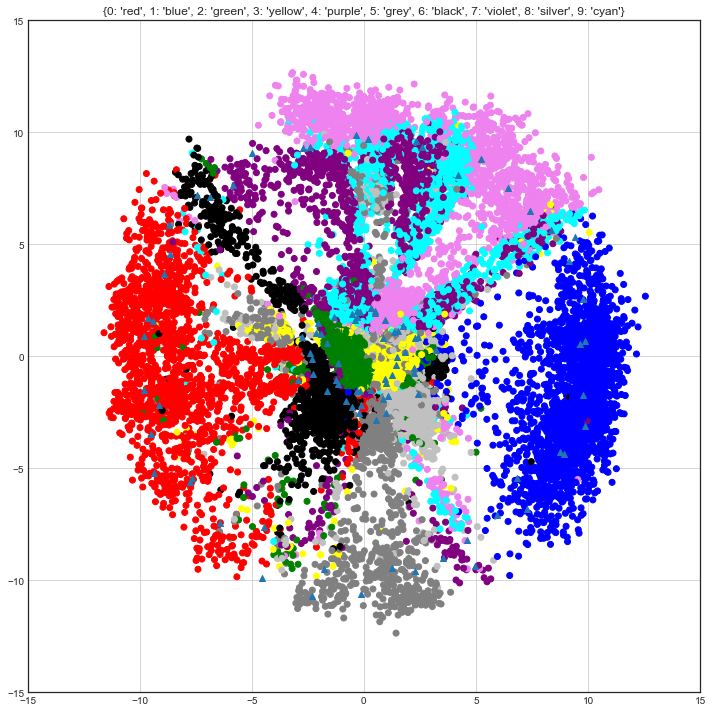

 iter: 1625 batch: 19900 range: 1.0109374613052016e-119 recon cost: 0.14273216 zero cost: 0.5369752								 one  cost: 0.48260868 fake cost: 1.90794584

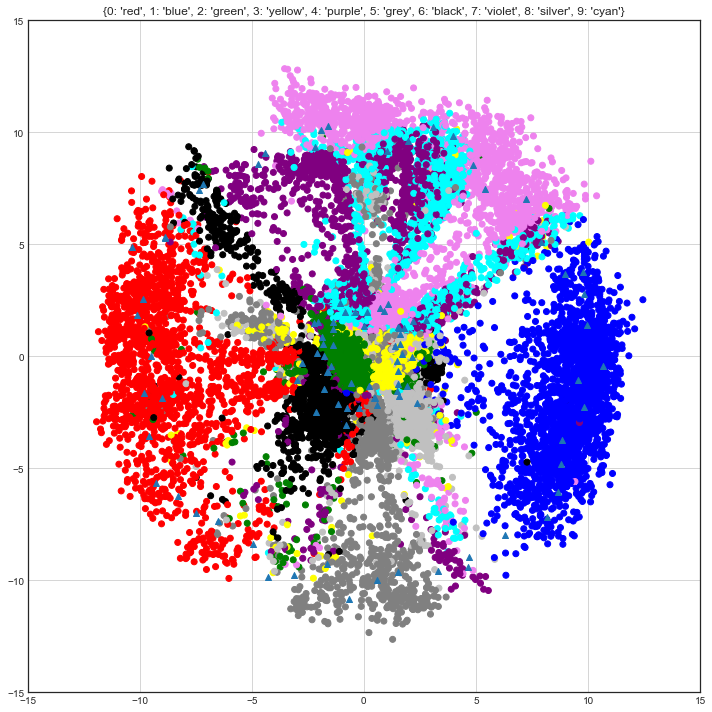

 iter: 1650 batch: 19900 range: 1.7385910232000638e-121 recon cost: 0.14233701 zero cost: 0.5491273								 one  cost: 0.47687325 fake cost: 1.80912144

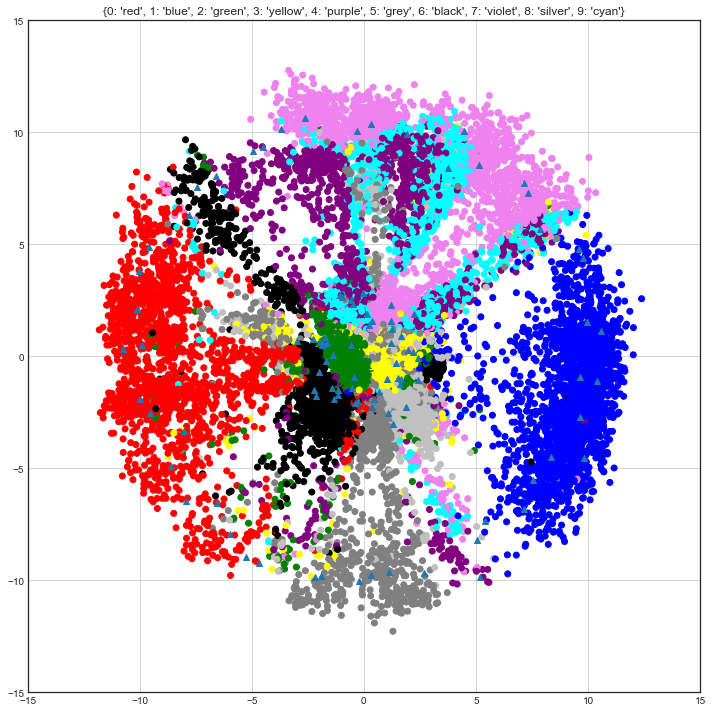

 iter: 1675 batch: 19900 range: 2.989995782775026e-123 recon cost: 0.14220472 zero cost: 0.5581639								 one  cost: 0.46847627 fake cost: 1.858738537

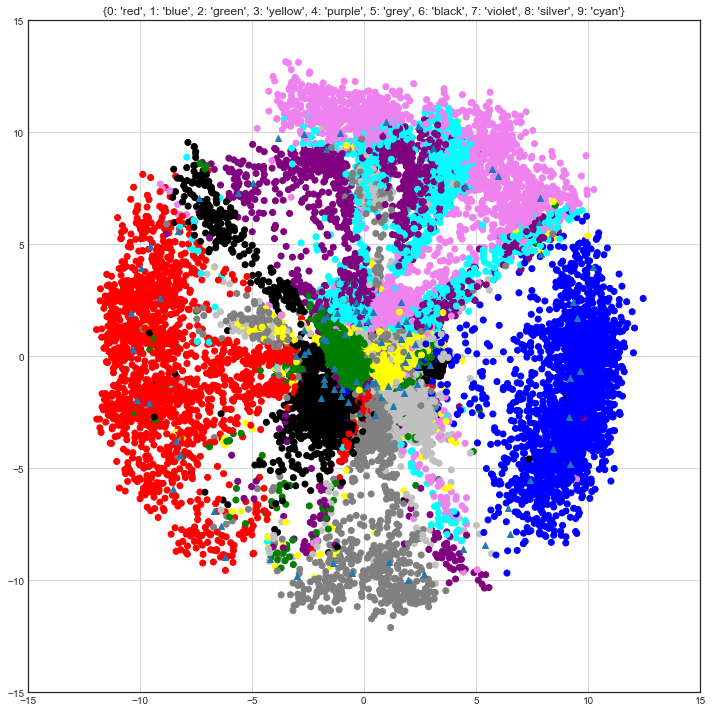

 iter: 1700 batch: 19900 range: 5.142137893106839e-125 recon cost: 0.14231542 zero cost: 0.54968035								 one  cost: 0.4317365 fake cost: 1.766738373

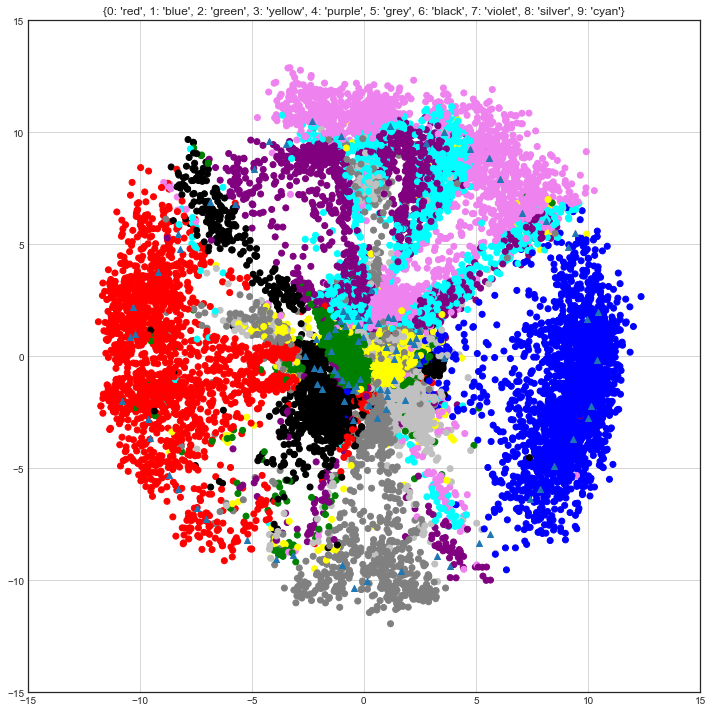

 iter: 1725 batch: 19900 range: 8.84335097194843e-127 recon cost: 0.14165087 zero cost: 0.5672855								 one  cost: 0.45750386 fake cost: 1.7579783275

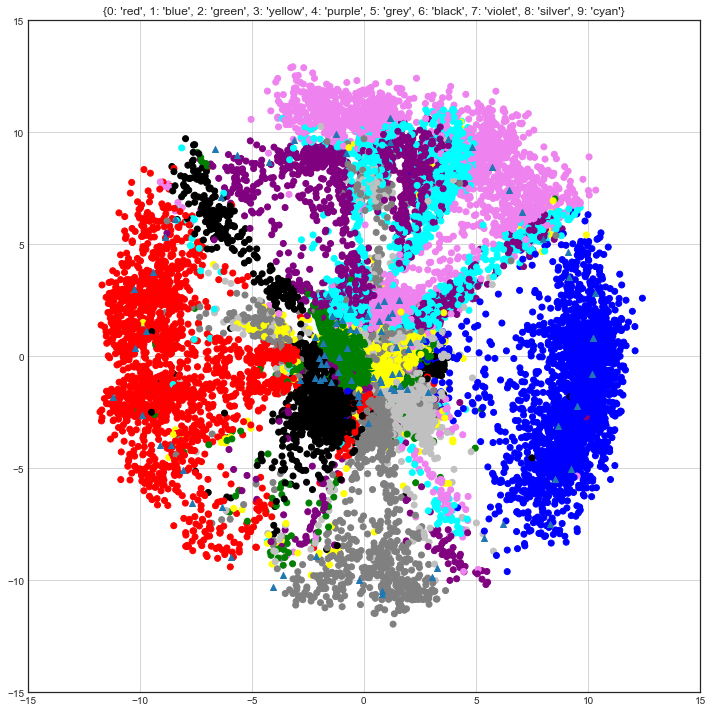

 iter: 1750 batch: 19900 range: 1.520862684719069e-128 recon cost: 0.14180395 zero cost: 0.56907326								 one  cost: 0.4056927 fake cost: 1.787366454

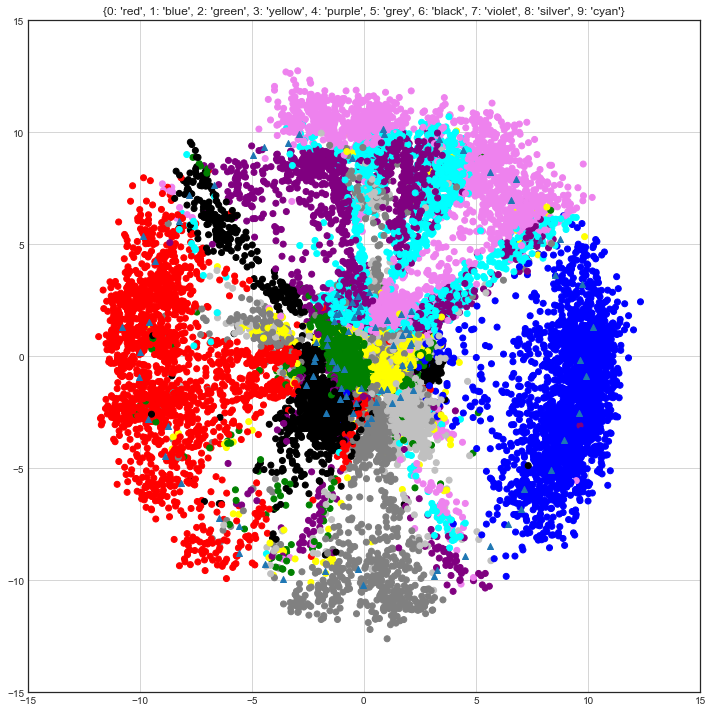

 iter: 1775 batch: 19900 range: 2.615550726311695e-130 recon cost: 0.14129111 zero cost: 0.5527428								 one  cost: 0.4454977 fake cost: 1.7951888111

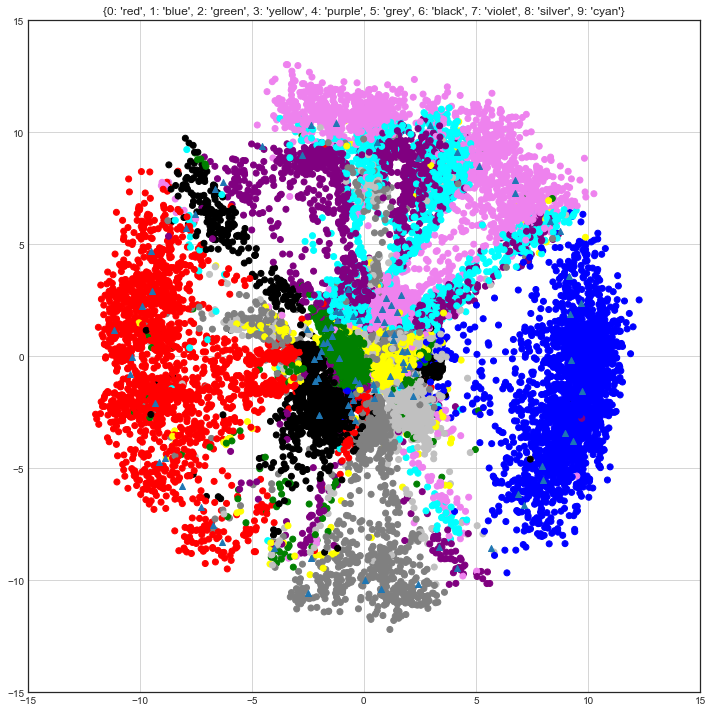

 iter: 1800 batch: 19900 range: 4.498174404991277e-132 recon cost: 0.14164001 zero cost: 0.5908098								 one  cost: 0.39519063 fake cost: 1.744116348

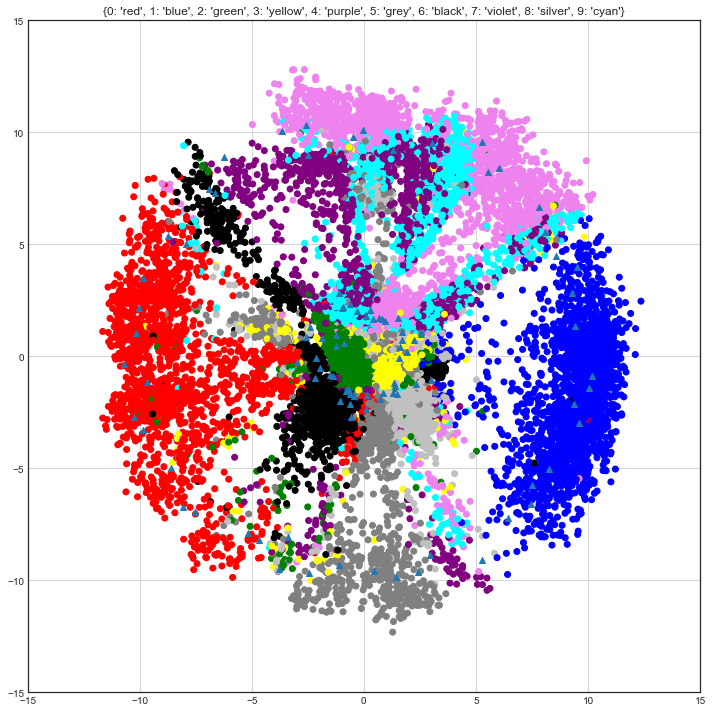

 iter: 1825 batch: 19900 range: 7.735874809910835e-134 recon cost: 0.1411304 zero cost: 0.5440018								 one  cost: 0.4492451 fake cost: 1.76712866262

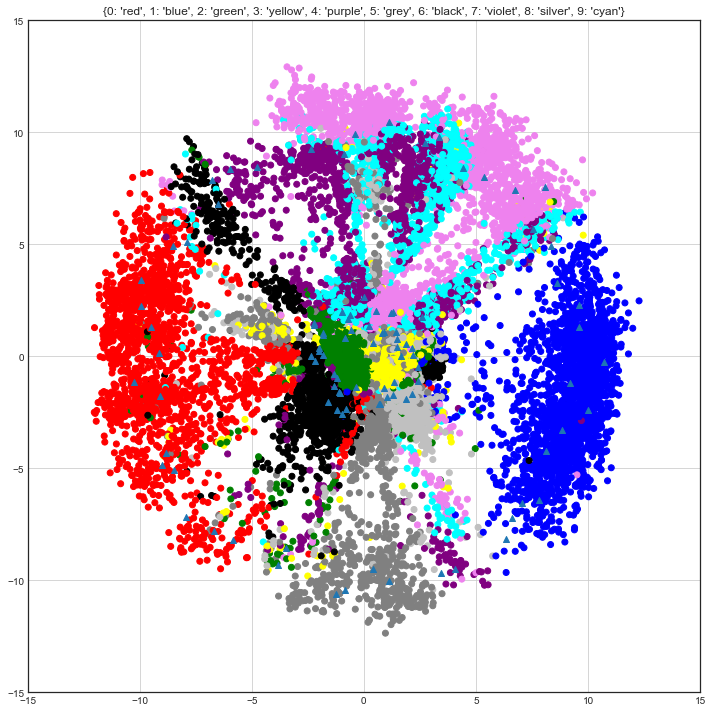

 iter: 1850 batch: 19900 range: 1.330401040213314e-135 recon cost: 0.14111258 zero cost: 0.5392816								 one  cost: 0.41892475 fake cost: 1.773843663

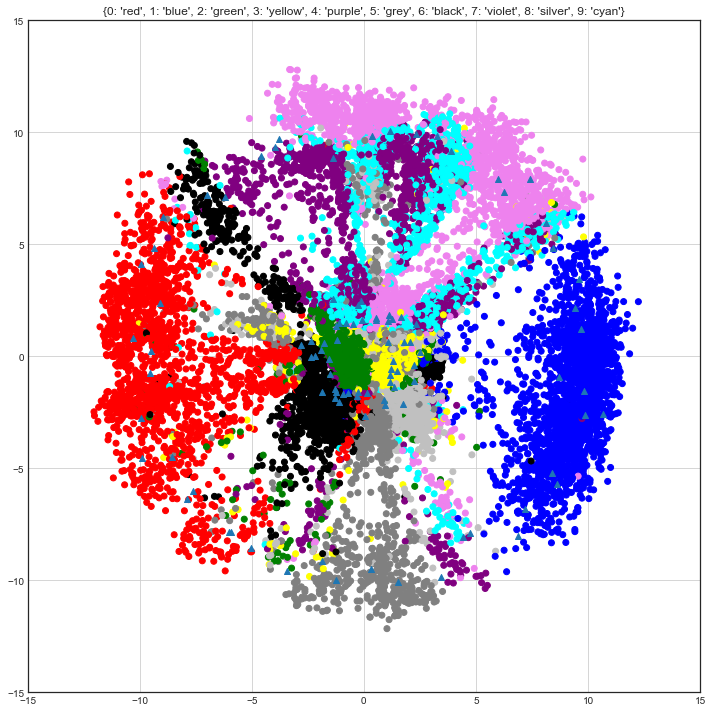

 iter: 1875 batch: 19900 range: 2.2879984116768174e-137 recon cost: 0.14115153 zero cost: 0.55170995								 one  cost: 0.47667396 fake cost: 1.7772828

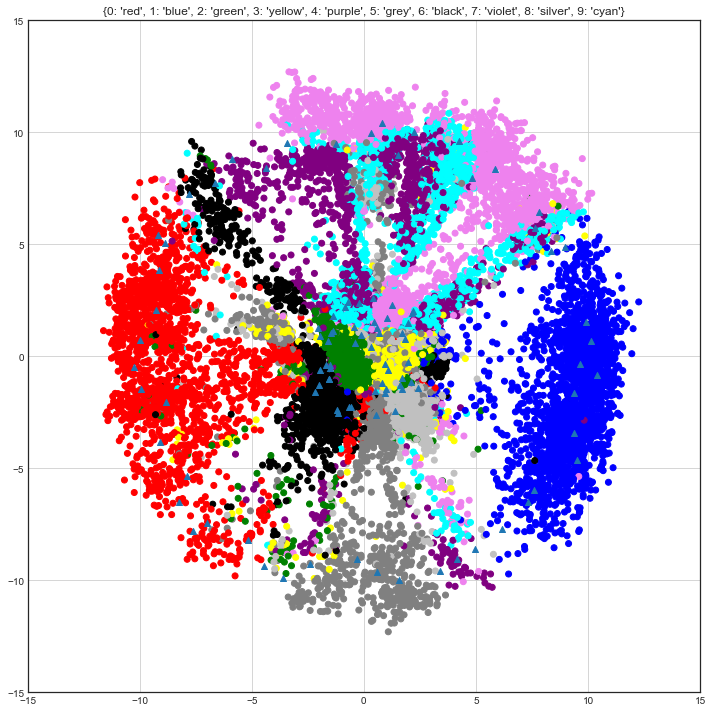

 iter: 1900 batch: 19900 range: 3.934856162617159e-139 recon cost: 0.14101903 zero cost: 0.557348								 one  cost: 0.450216 fake cost: 1.739053612834

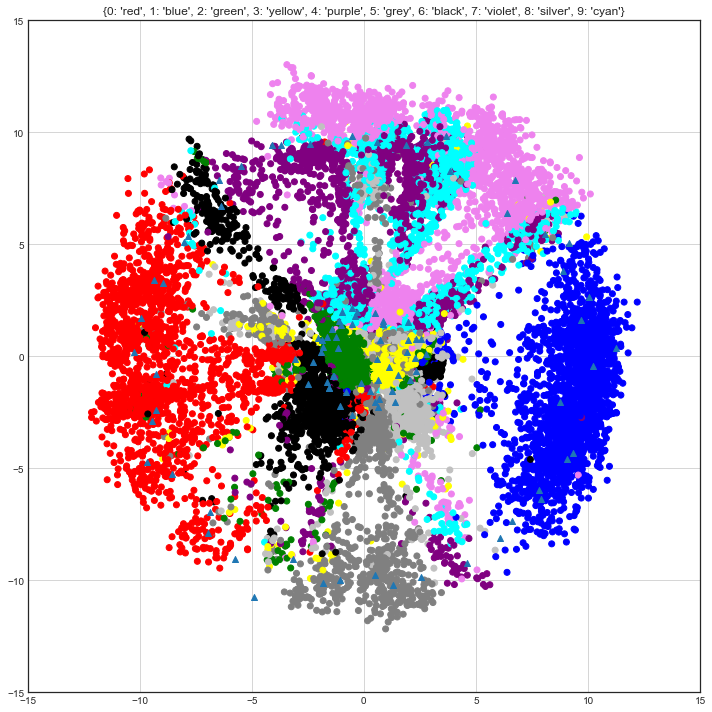

 iter: 1925 batch: 19900 range: 6.767090808047833e-141 recon cost: 0.14083852 zero cost: 0.57992846								 one  cost: 0.4269297 fake cost: 1.670613975

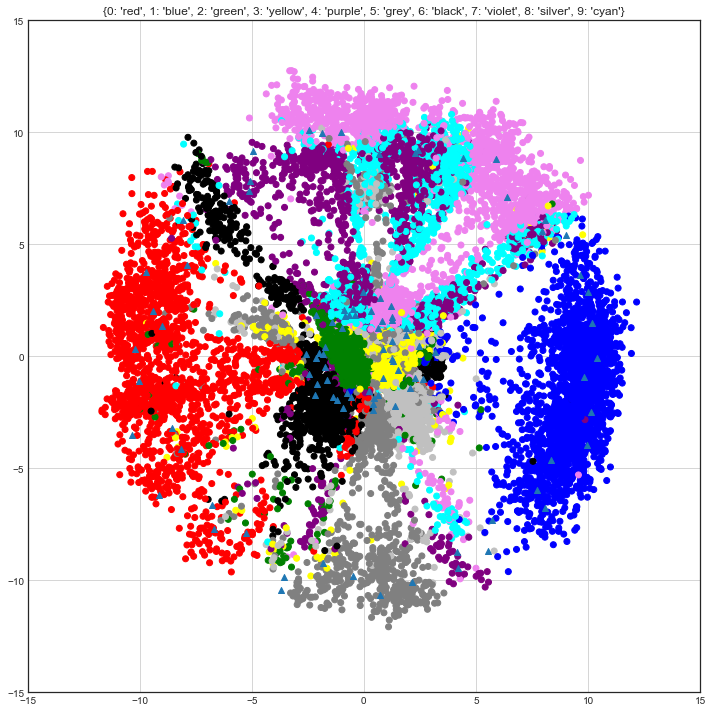

 iter: 1950 batch: 19900 range: 1.163791409694305e-142 recon cost: 0.14082885 zero cost: 0.55613524								 one  cost: 0.5165155 fake cost: 1.709382977

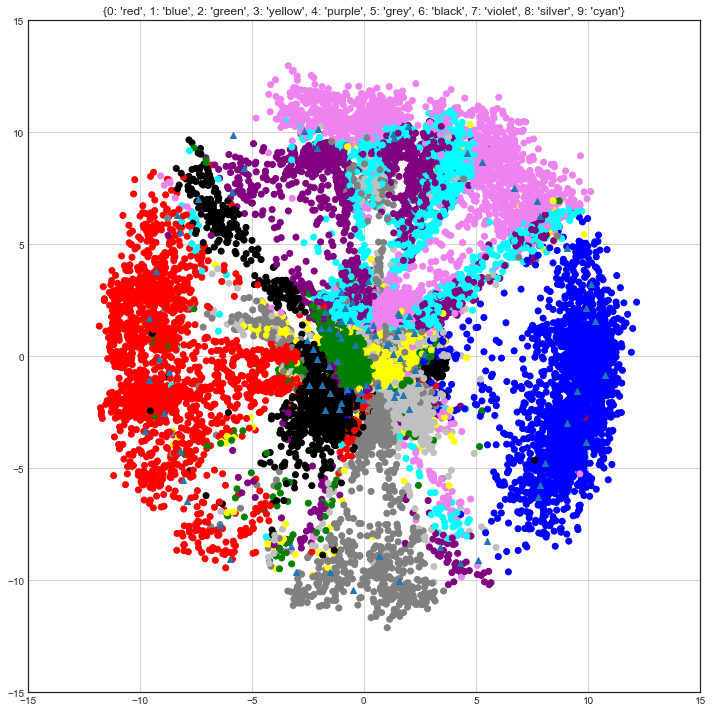

 iter: 1961 batch: 12200 range: 1.9475262947635376e-143 recon cost: 0.17125459 zero cost: 0.51285243								 one  cost: 0.5379368 fake cost: 1.61140112

In [ ]:
# start the session noise=.05
try:
    sess.run(tf.global_variables_initializer())
except:
    sess = tf.InteractiveSession()
sess.run(tf.global_variables_initializer())
train_batch_shuffled = train_batch.copy()
color_dict = {0:'red',1:'blue',2:'green',3:'yellow',4:'purple',5:'grey',6:'black',7:'violet',8:'silver',9:'cyan'}
from sklearn import manifold, datasets
image_num = 0
#                     00005
aimed_range_start = 0.00005
for iter in range(num_epoch):
    for current_data_index in range(0,len(train_batch),batch_size):
        prior_z,_    =  datasets.make_circles(n_samples=batch_size, factor=.2,noise=.05)
        prior_z = prior_z * 10
        current_data = train_batch_shuffled[current_data_index:current_data_index+batch_size].astype(np.float32)
    
        sess_result0 = sess.run([recon_cost,grad0_update],
        feed_dict={x0:current_data.reshape((batch_size,-1)),lr0:0.00005,aimed_range:aimed_range_start
        })

        sess_result1 = sess.run([dis_cost1,grad1_update],
        feed_dict={x1:current_data.reshape((batch_size,-1)),lr1:0.0001})

        sess_result2 = sess.run([dis_cost2,grad2_update],
        feed_dict={x2:prior_z                              ,lr2:0.0001})
        
        sess_result3 = sess.run([fake_cost,fake_grad_update],
        feed_dict={x3:current_data.reshape((batch_size,-1)),lr3:0.00005,aimed_range:aimed_range_start
                  })

        sys.stdout.write('\r iter: ' + str(iter) + ' batch: ' + str(current_data_index) + ' range: ' + str(aimed_range_start) + \
            ' recon cost: ' + str(sess_result0[0]) + \
            ' zero cost: ' + str(sess_result1[0]) + '\t\t\t\t\t\t\t\t' + \
            ' one  cost: ' + str(sess_result2[0]) + \
            ' fake cost: ' + str(sess_result3[0]) 
        ); sys.stdout.flush()
        
    aimed_range_start = aimed_range_start * 0.85   
    if iter % print_size == 0:
        random_idx = np.random.permutation(len(train_batch_shuffled))
        temp_data  = train_batch_shuffled[random_idx][:batch_size].reshape((batch_size,-1))
#         sess_result = sess.run(dlayer3,
#                       feed_dict={x0:temp_data }).reshape((batch_size,28,28))
#         fig=plt.figure(figsize=(15, 15)); columns = 10 ; rows = 1
#         for i in range(1, columns*rows +1):
#             fig.add_subplot(rows, columns, i)
#             if i % 2 ==0 :
#                   plt.imshow(np.squeeze(sess_result[i-2]),cmap='gray')
#             else:
#                 plt.imshow(np.squeeze(temp_data[i-1]).reshape((28,28)),cmap='gray')
#             plt.axis('off')
#         plt.show()
        
        # Show the latent space        
        all_latent_vectors = sess.run(elayer33,feed_dict={x3:train_batch[:batch_size].reshape((batch_size,-1))})
        for current_batch_index in range(batch_size,len(train_batch), batch_size):
            current_train_data = train_batch[current_batch_index:current_batch_index+batch_size]
            sess_results = sess.run(elayer33,feed_dict={x3:current_train_data.reshape((batch_size,-1))})
            all_latent_vectors = np.vstack((all_latent_vectors,sess_results))
        fig = plt.figure(figsize=(10,10))
        color_mapping = [color_dict[x] for x in np.argmax(train_label[:len(train_batch),:],1) ]
        plt.title(str(color_dict))
        plt.scatter(all_latent_vectors[:,0],all_latent_vectors[:,1],c=color_mapping)
        plt.scatter(prior_z[:,0],prior_z[:,1],marker='^')
        plt.xlim(-15,15);plt.ylim(-15,15);
        plt.grid(); plt.tight_layout()
        plt.savefig('./temp/'+str(image_num)+'.png',)
        plt.show()
        plt.close('all')
        image_num = image_num + 1

In [ ]:
# convert every data into latent to know the statistics
all_latent_vectors = sess.run(elayer3,feed_dict={x:train_batch[:batch_size].reshape((batch_size,-1))})
print(train_batch.shape)
print(all_latent_vectors.shape)
for current_batch_index in range(batch_size,len(train_batch), batch_size):
    current_train_data = train_batch[current_batch_index:current_batch_index+batch_size]
    sess_results = sess.run(elayer3,feed_dict={x:current_train_data.reshape((batch_size,-1))})
    all_latent_vectors = np.vstack((all_latent_vectors,sess_results))
print(all_latent_vectors.shape)

In [ ]:
# view the latent vectors
fig = plt.figure(figsize=(10,10))
color_dict = {
    0:'red',
    1:'blue',
    2:'green',
    3:'yellow',
    4:'purple',
    5:'grey',
    6:'black',
    7:'violet',
    8:'silver',
    9:'cyan',
}
color_mapping = [color_dict[x] for x in np.argmax(train_label[:len(train_batch),:],1) ]
plt.title(str(color_dict))
plt.scatter(all_latent_vectors[:,0],all_latent_vectors[:,1],c=color_mapping)
plt.grid()
plt.show()